In [1]:
import pandas as pd
import requests
import json
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt 
import warnings
warnings.filterwarnings('ignore')

pd.set_option('display.max_row',10000)
pd.set_option('display.max_columns',40)

In [2]:
# Pegando os dados utilizando o API do inmet a partir do site acima

#Para pegar dados das estações automáticas
url=requests.get('https://apitempo.inmet.gov.br/estacoes/T').json()
df_estacoes=pd.read_json(json.dumps(url))
df_estacoes.head(3)

,CD_OSCAR,DC_NOME,FL_CAPITAL,DT_FIM_OPERACAO,CD_SITUACAO,TP_ESTACAO,VL_LATITUDE,CD_WSI,CD_DISTRITO,VL_ALTITUDE,SG_ESTADO,SG_ENTIDADE,CD_ESTACAO,VL_LONGITUDE,DT_INICIO_OPERACAO
0,0-2000-0-86765,ABROLHOS,N,NaN,Pane,Automatica,-17.963056,0-76-0-2906907000000408,4,20.93,BA,INMET,A422,-38.703333,2008-07-20T21:00:00.000-03:00
1,0-2000-0-81755,ACARAU,N,NaN,Pane,Automatica,-3.121111,0-76-0-2300200000000446,3,67.15,CE,INMET,A360,-40.087222,2009-04-21T21:00:00.000-03:00
2,0-2000-0-86827,AFONSO CLAUDIO,None,NaN,Pane,Automatica,-20.104167,0-76-0-3200102000000478,6,507.48,ES,INMET,A657,-41.106944,2011-09-23T21:00:00.000-03:00


In [3]:
estacoes = ['A705','A714', 'A753', 'A733', 'A707', 'A701', 'A734']

aux = []
contador = 0
for estacao in estacoes[:-1]:
    condition = f'CD_ESTACAO == "{estacao}"|'
    condition1 = f'CD_ESTACAO == "{estacoes[-1]}"'
    aux.append(condition)
    contador+=1
    print(aux)
    print(contador)
    print('---'*10)
    
print('aux[0]+'*contador+'condition1')



['CD_ESTACAO == "A705"|']
1
------------------------------
['CD_ESTACAO == "A705"|', 'CD_ESTACAO == "A714"|']
2
------------------------------
['CD_ESTACAO == "A705"|', 'CD_ESTACAO == "A714"|', 'CD_ESTACAO == "A753"|']
3
------------------------------
['CD_ESTACAO == "A705"|', 'CD_ESTACAO == "A714"|', 'CD_ESTACAO == "A753"|', 'CD_ESTACAO == "A733"|']
4
------------------------------
['CD_ESTACAO == "A705"|', 'CD_ESTACAO == "A714"|', 'CD_ESTACAO == "A753"|', 'CD_ESTACAO == "A733"|', 'CD_ESTACAO == "A707"|']
5
------------------------------
['CD_ESTACAO == "A705"|', 'CD_ESTACAO == "A714"|', 'CD_ESTACAO == "A753"|', 'CD_ESTACAO == "A733"|', 'CD_ESTACAO == "A707"|', 'CD_ESTACAO == "A701"|']
6
------------------------------
aux[0]+aux[0]+aux[0]+aux[0]+aux[0]+aux[0]+condition1


In [4]:
condition = aux[0]+aux[1]+aux[2]+aux[3]+aux[4]+aux[5]+condition1


lista_estacoes = df_estacoes.query(condition)
lista_estacoes[['DC_NOME','CD_ESTACAO','VL_LATITUDE','VL_LONGITUDE','VL_ALTITUDE','DT_INICIO_OPERACAO','CD_SITUACAO']]

,DC_NOME,CD_ESTACAO,VL_LATITUDE,VL_LONGITUDE,VL_ALTITUDE,DT_INICIO_OPERACAO,CD_SITUACAO
64,BAURU,A705,-22.358052,-49.028877,636.17,2001-08-29T21:00:00.000-03:00,Operante
269,ITAPEVA,A714,-23.981944,-48.885833,743.33,2006-07-24T21:00:00.000-03:00,Operante
283,ITUVERAVA,A753,-20.359722,-47.775278,610.58,2008-07-16T21:00:00.000-03:00,Operante
290,JALES,A733,-20.165000,-50.595000,460.44,2007-08-21T21:00:00.000-03:00,Operante
443,PRESIDENTE PRUDENTE,A707,-22.119867,-51.408637,431.92,2003-02-03T22:00:00.000-02:00,Operante
525,SAO PAULO - MIRANTE,A701,-23.496294,-46.620088,785.64,2006-07-24T21:00:00.000-03:00,Operante
593,VALPARAISO,A734,-21.319167,-50.930278,381.90,2007-08-29T21:00:00.000-03:00,Operante


In [5]:
def lista_adicao_estacao(df = df_estacoes , 
                         estacoes = ['A705','A714', 'A753', 'A733', 'A707', 'A701', 'A734']):
    estacoes_cidades=[]
    adicionar_estacao = estacoes
    for i in adicionar_estacao:

        condition = df['CD_ESTACAO'] == i
        estacao = df.loc[condition]['DC_NOME'].values
        estacoes_cidades.append(estacao[0].capitalize())
        print(f'{i},{estacao[0]}')
    return estacoes_cidades

In [6]:
lista_nome_estacoes = lista_adicao_estacao()
lista_nome_estacoes

A705,BAURU
A714,ITAPEVA
A753,ITUVERAVA
A733,JALES
A707,PRESIDENTE PRUDENTE
A701,SAO PAULO - MIRANTE
A734,VALPARAISO


['Bauru',
 'Itapeva',
 'Ituverava',
 'Jales',
 'Presidente prudente',
 'Sao paulo - mirante',
 'Valparaiso']

In [7]:
def df_estacoes(data_inicio = '2011-01-01',data_fim = '2021-12-31',
               cod_estacao = 'A705' ):
    import requests
    import json
    geodata = 'https://github.com/tbrugz/geodata-br'
    
    url = f'https://apitempo.inmet.gov.br/estacao/{data_inicio}/{data_fim}/{cod_estacao}'
    x = requests.get(url).json()
    print(cod_estacao)
    print('Verifica se coluna cidade está escrito do jeito da geodata:',geodata)
    df = pd.read_json(json.dumps(x)) 
    print(df.DC_NOME[0].capitalize())
    return(df)

In [8]:
DF_A705_ANUAL =  df_estacoes(data_inicio = '2011-01-01',data_fim = '2022-01-01',cod_estacao = 'A705')
DF_A714_ANUAL =  df_estacoes(data_inicio = '2011-01-01',data_fim = '2022-01-01',cod_estacao = 'A714')
DF_A753_ANUAL =  df_estacoes(data_inicio = '2011-01-01',data_fim = '2022-01-01',cod_estacao = 'A753')
DF_A733_ANUAL =  df_estacoes(data_inicio = '2011-01-01',data_fim = '2022-01-01',cod_estacao = 'A733')
DF_A707_ANUAL =  df_estacoes(data_inicio = '2011-01-01',data_fim = '2022-01-01',cod_estacao = 'A707')
DF_A701_ANUAL =  df_estacoes(data_inicio = '2011-01-01',data_fim = '2022-01-01',cod_estacao = 'A701')
DF_A734_ANUAL =  df_estacoes(data_inicio = '2011-01-01',data_fim = '2022-01-01',cod_estacao = 'A734')

A705
Verifica se coluna cidade está escrito do jeito da geodata: https://github.com/tbrugz/geodata-br
Bauru
A714
Verifica se coluna cidade está escrito do jeito da geodata: https://github.com/tbrugz/geodata-br
Itapeva
A753
Verifica se coluna cidade está escrito do jeito da geodata: https://github.com/tbrugz/geodata-br
Ituverava
A733
Verifica se coluna cidade está escrito do jeito da geodata: https://github.com/tbrugz/geodata-br
Jales
A707
Verifica se coluna cidade está escrito do jeito da geodata: https://github.com/tbrugz/geodata-br
Presidente prudente
A701
Verifica se coluna cidade está escrito do jeito da geodata: https://github.com/tbrugz/geodata-br
Sao paulo - mirante
A734
Verifica se coluna cidade está escrito do jeito da geodata: https://github.com/tbrugz/geodata-br
Valparaiso


In [9]:
lista_nome_estacoes   #('Presidente prudente','Presidente Prudente')

['Bauru',
 'Itapeva',
 'Ituverava',
 'Jales',
 'Presidente prudente',
 'Sao paulo - mirante',
 'Valparaiso']

In [10]:
lista_nome_estacoes[4] ='Presidente Prudente'
lista_nome_estacoes[5] = 'São Paulo'
lista_nome_estacoes[6] = 'Valparaíso'

In [11]:
lista_nome_estacoes

['Bauru',
 'Itapeva',
 'Ituverava',
 'Jales',
 'Presidente Prudente',
 'São Paulo',
 'Valparaíso']

In [12]:
def coloca_nome_cidade(df, cidade, estacao):
    df['cidade'] = cidade
    df['estacao'] = estacao
    return df

In [14]:
# Se tiver acento é diferente e se diferente:  muda
### No caso 3 foram diferentes :Presidente prudente, Sao paulo - mirante e Valparaiso

coloca_nome_cidade(DF_A705_ANUAL,lista_nome_estacoes[0],'A705')
coloca_nome_cidade(DF_A714_ANUAL,lista_nome_estacoes[1],'A714')
coloca_nome_cidade(DF_A753_ANUAL,lista_nome_estacoes[2],'A753')
coloca_nome_cidade(DF_A733_ANUAL,lista_nome_estacoes[3],'A733')
coloca_nome_cidade(DF_A707_ANUAL,lista_nome_estacoes[4],'A707')
coloca_nome_cidade(DF_A701_ANUAL,lista_nome_estacoes[5],'A701')
coloca_nome_cidade(DF_A734_ANUAL,lista_nome_estacoes[6],'A734')

,DC_NOME,PRE_INS,TEM_SEN,VL_LATITUDE,PRE_MAX,UF,RAD_GLO,PTO_INS,TEM_MIN,VL_LONGITUDE,UMD_MIN,PTO_MAX,VEN_DIR,DT_MEDICAO,CHUVA,PRE_MIN,UMD_MAX,VEN_VEL,PTO_MIN,TEM_MAX,VEN_RAJ,TEM_INS,UMD_INS,CD_ESTACAO,HR_MEDICAO,cidade,estacao
0,VALPARAISO,962.5,25.6,-21.319167,962.5,SP,-3.540,18.0,25.0,-50.930278,60.0,18.0,164.0,2011-01-01,0.0,961.7,65.0,1.0,17.6,25.7,2.3,25.0,65.0,A734,0,Valparaíso,A734
1,VALPARAISO,963.5,25.4,-21.319167,963.5,SP,-3.540,18.9,24.0,-50.930278,65.0,19.9,110.0,2011-01-01,0.0,962.5,75.0,0.6,18.2,25.0,1.9,24.1,73.0,A734,100,Valparaíso,A734
2,VALPARAISO,964.0,25.6,-21.319167,964.0,SP,-3.540,19.1,23.6,-50.930278,71.0,19.3,202.0,2011-01-01,0.0,963.5,76.0,0.4,18.6,24.3,2.3,24.2,73.0,A734,200,Valparaíso,A734
3,VALPARAISO,964.0,23.1,-21.319167,964.2,SP,-3.540,19.2,24.1,-50.930278,67.0,19.3,113.0,2011-01-01,0.0,964.0,74.0,3.5,19.0,25.6,6.8,25.1,70.0,A734,300,Valparaíso,A734
4,VALPARAISO,963.2,23.4,-21.319167,963.9,SP,-3.293,19.3,23.9,-50.930278,70.0,19.3,107.0,2011-01-01,0.0,963.2,76.0,2.4,19.2,25.1,5.6,23.9,76.0,A734,400,Valparaíso,A734
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96451,VALPARAISO,962.0,28.8,-21.319167,962.6,SP,2686.430,20.4,29.8,-50.930278,53.0,22.3,40.0,2022-01-01,0.0,962.0,56.0,3.8,19.3,32.3,9.1,30.3,56.0,A734,1900,Valparaíso,A734
96452,VALPARAISO,962.0,26.7,-21.319167,962.2,SP,1936.479,19.0,29.1,-50.930278,53.0,20.9,42.0,2022-01-01,0.0,962.0,57.0,4.8,18.6,30.7,8.8,29.4,54.0,A734,2000,Valparaíso,A734
96453,VALPARAISO,962.1,25.9,-21.319167,962.1,SP,886.800,18.5,27.7,-50.930278,53.0,19.5,50.0,2022-01-01,0.0,961.8,57.0,3.3,18.3,29.8,7.4,27.7,57.0,A734,2100,Valparaíso,A734
96454,VALPARAISO,962.9,26.0,-21.319167,962.9,SP,121.511,18.9,26.2,-50.930278,57.0,18.9,29.0,2022-01-01,0.0,962.2,64.0,2.0,18.5,27.8,5.7,26.2,64.0,A734,2200,Valparaíso,A734


# Verfica se o nome está certo agora:
 
 Tem que corresponder com o dentro do <a href='https://raw.githubusercontent.com/tbrugz/geodata-br/master/geojson/geojs-35-mun.json'>link</a>, se a cidade for no estado de São Paulo.
 Se não, procurar o correspondente <a href='https://github.com/tbrugz/geodata-br'>aqui</a> para poder gerar os mapas mais a frente.

In [15]:
DF_A734_ANUAL

,DC_NOME,PRE_INS,TEM_SEN,VL_LATITUDE,PRE_MAX,UF,RAD_GLO,PTO_INS,TEM_MIN,VL_LONGITUDE,UMD_MIN,PTO_MAX,VEN_DIR,DT_MEDICAO,CHUVA,PRE_MIN,UMD_MAX,VEN_VEL,PTO_MIN,TEM_MAX,VEN_RAJ,TEM_INS,UMD_INS,CD_ESTACAO,HR_MEDICAO,cidade,estacao
0,VALPARAISO,962.5,25.6,-21.319167,962.5,SP,-3.540,18.0,25.0,-50.930278,60.0,18.0,164.0,2011-01-01,0.0,961.7,65.0,1.0,17.6,25.7,2.3,25.0,65.0,A734,0,Valparaíso,A734
1,VALPARAISO,963.5,25.4,-21.319167,963.5,SP,-3.540,18.9,24.0,-50.930278,65.0,19.9,110.0,2011-01-01,0.0,962.5,75.0,0.6,18.2,25.0,1.9,24.1,73.0,A734,100,Valparaíso,A734
2,VALPARAISO,964.0,25.6,-21.319167,964.0,SP,-3.540,19.1,23.6,-50.930278,71.0,19.3,202.0,2011-01-01,0.0,963.5,76.0,0.4,18.6,24.3,2.3,24.2,73.0,A734,200,Valparaíso,A734
3,VALPARAISO,964.0,23.1,-21.319167,964.2,SP,-3.540,19.2,24.1,-50.930278,67.0,19.3,113.0,2011-01-01,0.0,964.0,74.0,3.5,19.0,25.6,6.8,25.1,70.0,A734,300,Valparaíso,A734
4,VALPARAISO,963.2,23.4,-21.319167,963.9,SP,-3.293,19.3,23.9,-50.930278,70.0,19.3,107.0,2011-01-01,0.0,963.2,76.0,2.4,19.2,25.1,5.6,23.9,76.0,A734,400,Valparaíso,A734
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96451,VALPARAISO,962.0,28.8,-21.319167,962.6,SP,2686.430,20.4,29.8,-50.930278,53.0,22.3,40.0,2022-01-01,0.0,962.0,56.0,3.8,19.3,32.3,9.1,30.3,56.0,A734,1900,Valparaíso,A734
96452,VALPARAISO,962.0,26.7,-21.319167,962.2,SP,1936.479,19.0,29.1,-50.930278,53.0,20.9,42.0,2022-01-01,0.0,962.0,57.0,4.8,18.6,30.7,8.8,29.4,54.0,A734,2000,Valparaíso,A734
96453,VALPARAISO,962.1,25.9,-21.319167,962.1,SP,886.800,18.5,27.7,-50.930278,53.0,19.5,50.0,2022-01-01,0.0,961.8,57.0,3.3,18.3,29.8,7.4,27.7,57.0,A734,2100,Valparaíso,A734
96454,VALPARAISO,962.9,26.0,-21.319167,962.9,SP,121.511,18.9,26.2,-50.930278,57.0,18.9,29.0,2022-01-01,0.0,962.2,64.0,2.0,18.5,27.8,5.7,26.2,64.0,A734,2200,Valparaíso,A734


---

In [16]:
#trasformando a data em datetime
DF_A705_ANUAL.loc[:,'DT_MEDICAO'] =  pd.to_datetime(DF_A705_ANUAL.loc[:,'DT_MEDICAO'], format='%Y-%m-%d')
DF_A714_ANUAL.loc[:,'DT_MEDICAO'] =  pd.to_datetime(DF_A714_ANUAL.loc[:,'DT_MEDICAO'], format='%Y-%m-%d')
DF_A753_ANUAL.loc[:,'DT_MEDICAO'] =  pd.to_datetime(DF_A753_ANUAL.loc[:,'DT_MEDICAO'], format='%Y-%m-%d')
DF_A733_ANUAL.loc[:,'DT_MEDICAO'] =  pd.to_datetime(DF_A733_ANUAL.loc[:,'DT_MEDICAO'], format='%Y-%m-%d')
DF_A707_ANUAL.loc[:,'DT_MEDICAO'] =  pd.to_datetime(DF_A707_ANUAL.loc[:,'DT_MEDICAO'], format='%Y-%m-%d')
DF_A701_ANUAL.loc[:,'DT_MEDICAO'] =  pd.to_datetime(DF_A701_ANUAL.loc[:,'DT_MEDICAO'], format='%Y-%m-%d')
DF_A734_ANUAL.loc[:,'DT_MEDICAO'] =  pd.to_datetime(DF_A734_ANUAL.loc[:,'DT_MEDICAO'], format='%Y-%m-%d')

#criando a coluna mês
DF_A705_ANUAL.loc[:,'MES'] = DF_A705_ANUAL.loc[:,'DT_MEDICAO'].dt.month
DF_A714_ANUAL.loc[:,'MES'] = DF_A714_ANUAL.loc[:,'DT_MEDICAO'].dt.month
DF_A753_ANUAL.loc[:,'MES'] = DF_A753_ANUAL.loc[:,'DT_MEDICAO'].dt.month
DF_A733_ANUAL.loc[:,'MES'] = DF_A733_ANUAL.loc[:,'DT_MEDICAO'].dt.month
DF_A707_ANUAL.loc[:,'MES'] = DF_A707_ANUAL.loc[:,'DT_MEDICAO'].dt.month
DF_A701_ANUAL.loc[:,'MES'] = DF_A701_ANUAL.loc[:,'DT_MEDICAO'].dt.month
DF_A734_ANUAL.loc[:,'MES'] = DF_A734_ANUAL.loc[:,'DT_MEDICAO'].dt.month

#criando a coluna ano
DF_A705_ANUAL.loc[:,'ANO'] = DF_A705_ANUAL.loc[:,'DT_MEDICAO'].dt.year
DF_A714_ANUAL.loc[:,'ANO'] = DF_A714_ANUAL.loc[:,'DT_MEDICAO'].dt.year
DF_A753_ANUAL.loc[:,'ANO'] = DF_A753_ANUAL.loc[:,'DT_MEDICAO'].dt.year
DF_A733_ANUAL.loc[:,'ANO'] = DF_A733_ANUAL.loc[:,'DT_MEDICAO'].dt.year
DF_A707_ANUAL.loc[:,'ANO'] = DF_A707_ANUAL.loc[:,'DT_MEDICAO'].dt.year
DF_A701_ANUAL.loc[:,'ANO'] = DF_A701_ANUAL.loc[:,'DT_MEDICAO'].dt.year
DF_A734_ANUAL.loc[:,'ANO'] = DF_A734_ANUAL.loc[:,'DT_MEDICAO'].dt.year

In [17]:
DF_A734_ANUAL

,DC_NOME,PRE_INS,TEM_SEN,VL_LATITUDE,PRE_MAX,UF,RAD_GLO,PTO_INS,TEM_MIN,VL_LONGITUDE,UMD_MIN,PTO_MAX,VEN_DIR,DT_MEDICAO,CHUVA,PRE_MIN,UMD_MAX,VEN_VEL,PTO_MIN,TEM_MAX,VEN_RAJ,TEM_INS,UMD_INS,CD_ESTACAO,HR_MEDICAO,cidade,estacao,MES,ANO
0,VALPARAISO,962.5,25.6,-21.319167,962.5,SP,-3.540,18.0,25.0,-50.930278,60.0,18.0,164.0,2011-01-01,0.0,961.7,65.0,1.0,17.6,25.7,2.3,25.0,65.0,A734,0,Valparaíso,A734,1,2011
1,VALPARAISO,963.5,25.4,-21.319167,963.5,SP,-3.540,18.9,24.0,-50.930278,65.0,19.9,110.0,2011-01-01,0.0,962.5,75.0,0.6,18.2,25.0,1.9,24.1,73.0,A734,100,Valparaíso,A734,1,2011
2,VALPARAISO,964.0,25.6,-21.319167,964.0,SP,-3.540,19.1,23.6,-50.930278,71.0,19.3,202.0,2011-01-01,0.0,963.5,76.0,0.4,18.6,24.3,2.3,24.2,73.0,A734,200,Valparaíso,A734,1,2011
3,VALPARAISO,964.0,23.1,-21.319167,964.2,SP,-3.540,19.2,24.1,-50.930278,67.0,19.3,113.0,2011-01-01,0.0,964.0,74.0,3.5,19.0,25.6,6.8,25.1,70.0,A734,300,Valparaíso,A734,1,2011
4,VALPARAISO,963.2,23.4,-21.319167,963.9,SP,-3.293,19.3,23.9,-50.930278,70.0,19.3,107.0,2011-01-01,0.0,963.2,76.0,2.4,19.2,25.1,5.6,23.9,76.0,A734,400,Valparaíso,A734,1,2011
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96451,VALPARAISO,962.0,28.8,-21.319167,962.6,SP,2686.430,20.4,29.8,-50.930278,53.0,22.3,40.0,2022-01-01,0.0,962.0,56.0,3.8,19.3,32.3,9.1,30.3,56.0,A734,1900,Valparaíso,A734,1,2022
96452,VALPARAISO,962.0,26.7,-21.319167,962.2,SP,1936.479,19.0,29.1,-50.930278,53.0,20.9,42.0,2022-01-01,0.0,962.0,57.0,4.8,18.6,30.7,8.8,29.4,54.0,A734,2000,Valparaíso,A734,1,2022
96453,VALPARAISO,962.1,25.9,-21.319167,962.1,SP,886.800,18.5,27.7,-50.930278,53.0,19.5,50.0,2022-01-01,0.0,961.8,57.0,3.3,18.3,29.8,7.4,27.7,57.0,A734,2100,Valparaíso,A734,1,2022
96454,VALPARAISO,962.9,26.0,-21.319167,962.9,SP,121.511,18.9,26.2,-50.930278,57.0,18.9,29.0,2022-01-01,0.0,962.2,64.0,2.0,18.5,27.8,5.7,26.2,64.0,A734,2200,Valparaíso,A734,1,2022


In [18]:
# Transformando o DF_A714_ANUAL['HR_MEDICAO'] que está em UTC para o correspondente para o BRASIL.
# Sendo a hora 0 = 21h.
# Criando uma coluna ['HR'] para esses valores

def hora_UTC(df):
    hora_br = 0
    HORA=[]

    for hora in df['HR_MEDICAO']:
        if hora/100+21 >= 25:
            hora_br = (hora/100+21)-24
        else:
            hora_br = hora/100+21
        HORA.append(hora_br)
    df.loc[:,'HR'] = HORA
    #return df['HR']

In [19]:
# Usando a função para toddas as estações
hora_UTC(DF_A705_ANUAL)
hora_UTC(DF_A714_ANUAL)
hora_UTC(DF_A753_ANUAL)
hora_UTC(DF_A733_ANUAL)
hora_UTC(DF_A707_ANUAL)
hora_UTC(DF_A701_ANUAL)
hora_UTC(DF_A734_ANUAL)


# ATRIBUTOS DIARIOS


|    CAMPO    |     DESCRIÇÃO    | UNIDADE |
|-------------|------------------|---------|
|CHUVA	      |PRECIPITAÇÃO TOTAL|  mm     |
|PRESS_ATM_MED|PRESSAO ATM. MEDIA|	mB     |
|TEMP_MAX	  |TEMPERATURA MÁXIMA| 	°C     |
|TEMP_MED	  |TEMPERATURA MÉDIA | 	°C     |
|TEMP_MIN	  |TEMPERATURA MÍNIMA|  °C     |
|UMID_MED	  |UMIDADE REL. DO AR| 	 %     |
|UMID_MIN	  |UMIDADE REL. DO AR|   %     |
|VEL_VENTO_MED|VELOCIDADE MÉDIA  |	m/s    |


# Tratamento de Null:

In [20]:
#DF_A714_ANUAL.loc[DF_A714_ANUAL['CHUVA'].isnull(),'CHUVA']=0  #ou
DF_A714_ANUAL.loc[:,'CHUVA'].fillna(0.0, inplace=True)
DF_A753_ANUAL.loc[:,'CHUVA'].fillna(0.0, inplace=True)
DF_A733_ANUAL.loc[:,'CHUVA'].fillna(0.0, inplace=True)
DF_A707_ANUAL.loc[:,'CHUVA'].fillna(0.0, inplace=True)
DF_A701_ANUAL.loc[:,'CHUVA'].fillna(0.0, inplace=True)
DF_A734_ANUAL.loc[:,'CHUVA'].fillna(0.0, inplace=True)

In [21]:
def treat_null_RAD(df):
    condiction = df.loc[:,'HR']>=21.0                   # condição se o horário é mais que 21h
    df.loc[:,'RAD']  = np.where(condiction, 0.0 ,df.loc[:,'RAD_GLO'])
    condiction2 = df.loc[:,'HR'] <= 5.0                 # condição se o horário é menos que 5h
    df['RAD']  = np.where(condiction2, 0.0 ,df['RAD'])
    df['RAD']  = df['RAD'].apply(lambda x: 0.0 if x<0 else x) # ou se negativo é igual a zero
    
    # Fazendo o tratamento do restante dos nulls com o method=ffill
    df.fillna(method='ffill',axis=0,inplace=True)

In [22]:
# Fazendo a função acima para todas as estações:
treat_null_RAD(DF_A705_ANUAL)
treat_null_RAD(DF_A714_ANUAL)
treat_null_RAD(DF_A753_ANUAL)
treat_null_RAD(DF_A733_ANUAL)
treat_null_RAD(DF_A707_ANUAL)
treat_null_RAD(DF_A701_ANUAL)
treat_null_RAD(DF_A734_ANUAL)

In [23]:
#média diária - médias por dia durante 2011 a 2021

df_dia_A705 = DF_A705_ANUAL.groupby(['DT_MEDICAO'],as_index=False).mean()
df_dia_A714 = DF_A714_ANUAL.groupby(['DT_MEDICAO'],as_index=False).mean()
df_dia_A753 = DF_A753_ANUAL.groupby(['DT_MEDICAO'],as_index=False).mean()
df_dia_A733 = DF_A733_ANUAL.groupby(['DT_MEDICAO'],as_index=False).mean()
df_dia_A707 = DF_A707_ANUAL.groupby(['DT_MEDICAO'],as_index=False).mean()
df_dia_A701 = DF_A701_ANUAL.groupby(['DT_MEDICAO'],as_index=False).mean()
df_dia_A734 = DF_A734_ANUAL.groupby(['DT_MEDICAO'],as_index=False).mean()

In [24]:
DF_ESTACOES = pd.concat([DF_A705_ANUAL,DF_A714_ANUAL,DF_A753_ANUAL,DF_A733_ANUAL,DF_A707_ANUAL,DF_A701_ANUAL,DF_A734_ANUAL]).reset_index(drop=True)
#DF_ESTACOES.to_csv('DF_ESTACOES.csv',sep=';',index=False)

In [25]:
lista_nome_estacoes

['Bauru',
 'Itapeva',
 'Ituverava',
 'Jales',
 'Presidente Prudente',
 'São Paulo',
 'Valparaíso']

In [26]:
lista_nome_estacoes[5]

'São Paulo'

In [27]:

coloca_nome_cidade(df_dia_A705,lista_nome_estacoes[0],'A705' )
coloca_nome_cidade(df_dia_A714,lista_nome_estacoes[1],'A714' )
coloca_nome_cidade(df_dia_A753,lista_nome_estacoes[2],'A753' )
coloca_nome_cidade(df_dia_A733,lista_nome_estacoes[3],'A733' )
coloca_nome_cidade(df_dia_A707,lista_nome_estacoes[4],'A707' )
coloca_nome_cidade(df_dia_A701,lista_nome_estacoes[5],'A701' )
coloca_nome_cidade(df_dia_A734,lista_nome_estacoes[6],'A734' )

,DT_MEDICAO,PRE_INS,TEM_SEN,VL_LATITUDE,PRE_MAX,RAD_GLO,PTO_INS,TEM_MIN,VL_LONGITUDE,UMD_MIN,PTO_MAX,VEN_DIR,CHUVA,PRE_MIN,UMD_MAX,VEN_VEL,PTO_MIN,TEM_MAX,VEN_RAJ,TEM_INS,UMD_INS,HR_MEDICAO,MES,ANO,HR,RAD,cidade,estacao
0,2011-01-01,962.291667,25.558333,-21.319167,962.595833,1089.302958,19.237500,25.470833,-50.930278,62.833333,19.870833,131.166667,0.025000,962.037500,70.625000,2.425000,18.604167,26.925000,5.554167,26.162500,66.958333,1150.0,1.0,2011.0,12.5,1090.620167,Valparaíso,A734
1,2011-01-02,961.129167,24.325000,-21.319167,961.470833,823.670750,21.312500,24.308333,-50.930278,77.500000,22.091667,108.000000,1.058333,960.825000,85.000000,2.883333,20.737500,25.570833,5.995833,24.829167,81.875000,1150.0,1.0,2011.0,12.5,824.404167,Valparaíso,A734
2,2011-01-03,960.566667,25.862500,-21.319167,960.854167,957.079292,20.916667,24.458333,-50.930278,76.708333,21.558333,153.000000,0.016667,960.333333,82.916667,1.854167,20.433333,25.616667,4.700000,25.162500,79.125000,1150.0,1.0,2011.0,12.5,957.640917,Valparaíso,A734
3,2011-01-04,962.066667,26.362500,-21.319167,962.300000,804.137250,21.625000,24.300000,-50.930278,78.083333,22.233333,135.583333,1.666667,961.608333,86.375000,1.350000,20.929167,25.925000,4.583333,25.012500,83.041667,1150.0,1.0,2011.0,12.5,805.462708,Valparaíso,A734
4,2011-01-05,965.941667,26.008333,-21.319167,966.179167,894.198750,20.787500,24.270833,-50.930278,77.083333,21.329167,150.250000,0.425000,965.633333,83.125000,1.279167,20.137500,25.225000,3.533333,24.758333,80.250000,1150.0,1.0,2011.0,12.5,894.908000,Valparaíso,A734
5,2011-01-06,967.045833,27.091667,-21.319167,967.333333,1029.743208,20.966667,25.720833,-50.930278,70.166667,21.766667,82.875000,0.000000,966.783333,78.291667,1.720833,20.158333,27.033333,4.737500,26.387500,74.208333,1150.0,1.0,2011.0,12.5,1031.042375,Valparaíso,A734
6,2011-01-07,967.454167,26.416667,-21.319167,967.762500,927.990625,21.420833,25.095833,-50.930278,75.250000,22.179167,107.333333,0.233333,967.116667,82.333333,1.895833,20.712500,26.291667,5.429167,25.708333,78.875000,1150.0,1.0,2011.0,12.5,928.634625,Valparaíso,A734
7,2011-01-08,968.000000,24.220833,-21.319167,968.279167,631.636417,21.466667,23.808333,-50.930278,80.583333,22.054167,130.958333,0.475000,967.645833,87.625000,2.650000,20.862500,25.058333,5.895833,24.383333,84.375000,1150.0,1.0,2011.0,12.5,632.475125,Valparaíso,A734
8,2011-01-09,966.362500,25.354167,-21.319167,966.712500,740.696083,21.620833,23.775000,-50.930278,82.291667,21.995833,187.250000,0.441667,966.125000,88.333333,1.712500,21.020833,24.808333,4.550000,24.279167,85.916667,1150.0,1.0,2011.0,12.5,741.621208,Valparaíso,A734
9,2011-01-10,963.645833,27.154167,-21.319167,964.025000,879.106958,21.870833,25.170833,-50.930278,77.708333,22.500000,187.208333,0.600000,963.383333,84.083333,1.387500,21.320833,26.404167,3.950000,25.762500,80.833333,1150.0,1.0,2011.0,12.5,880.353250,Valparaíso,A734


In [28]:
soma = [df_dia_A705,df_dia_A714,df_dia_A753,df_dia_A733,df_dia_A707,df_dia_A701,df_dia_A734]

df_dia_estacoes = pd.concat(soma).reset_index(drop=True)
#df_dia_estacoes.to_csv('DF_ESTACOES.csv',sep=';',index=False)

In [29]:
df_dia_estacoes

,DT_MEDICAO,PRE_INS,TEM_SEN,VL_LATITUDE,PRE_MAX,RAD_GLO,PTO_INS,TEM_MIN,VL_LONGITUDE,UMD_MIN,PTO_MAX,VEN_DIR,CHUVA,PRE_MIN,UMD_MAX,VEN_VEL,PTO_MIN,TEM_MAX,VEN_RAJ,TEM_INS,UMD_INS,HR_MEDICAO,MES,ANO,HR,RAD,cidade,estacao
0,2011-01-01,935.975000,23.704167,-22.358052,936.254167,860.491875,17.912500,23.391667,-49.028877,66.958333,18.258333,125.208333,0.000000,935.766667,72.166667,1.895833,17.495833,24.533333,6.100000,23.945833,69.875000,1150.0,1.0,2011.0,12.5,861.936667,Bauru,A705
1,2011-01-02,934.904167,23.387500,-22.358052,935.200000,640.485000,19.266667,22.320833,-49.028877,77.125000,19.695833,112.958333,0.491667,934.612500,83.833333,1.650000,18.833333,23.587500,5.708333,22.812500,81.083333,1150.0,1.0,2011.0,12.5,641.840208,Bauru,A705
2,2011-01-03,934.037500,21.516667,-22.358052,934.333333,454.924708,20.162500,20.504167,-49.028877,94.416667,20.479167,74.041667,1.950000,933.850000,96.375000,1.975000,19.866667,21.333333,5.475000,20.916667,95.541667,1150.0,1.0,2011.0,12.5,455.632208,Bauru,A705
3,2011-01-04,934.900000,25.337500,-22.358052,935.112500,843.190833,20.920833,23.225000,-49.028877,82.291667,21.320833,236.291667,0.350000,934.570833,88.833333,1.145833,20.416667,24.362500,4.095833,23.783333,85.708333,1150.0,1.0,2011.0,12.5,844.200167,Bauru,A705
4,2011-01-05,938.820833,24.908333,-22.358052,939.020833,883.095417,20.587500,23.220833,-49.028877,79.791667,21.183333,198.583333,0.108333,938.458333,87.291667,1.583333,20.008333,24.412500,5.470833,23.891667,83.416667,1150.0,1.0,2011.0,12.5,884.217000,Bauru,A705
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28128,2021-12-28,965.479167,26.829167,-21.319167,965.745833,1068.376000,17.141667,26.675000,-50.930278,51.500000,17.662500,125.875000,0.083333,965.108333,57.541667,2.179167,16.066667,28.979167,5.695833,27.720833,55.375000,1150.0,12.0,2021.0,12.5,1069.700417,Valparaíso,A734
28129,2021-12-29,968.300000,23.045833,-21.319167,968.612500,393.359875,19.487500,23.645833,-50.930278,74.625000,20.016667,130.250000,0.100000,967.837500,76.875000,2.791667,19.129167,24.620833,6.162500,24.062500,75.666667,1150.0,12.0,2021.0,12.5,394.798167,Valparaíso,A734
28130,2021-12-30,966.670833,23.858333,-21.319167,966.991667,746.964042,19.929167,23.295833,-50.930278,77.291667,20.666667,112.541667,0.008333,966.491667,80.666667,2.208333,19.458333,24.833333,4.887500,23.912500,79.000000,1150.0,12.0,2021.0,12.5,748.348375,Valparaíso,A734
28131,2021-12-31,963.179167,25.237500,-21.319167,963.504167,968.476875,19.725000,23.695833,-50.930278,74.166667,20.429167,125.208333,0.066667,962.933333,78.750000,1.529167,18.995833,25.375000,4.550000,24.558333,76.291667,1150.0,12.0,2021.0,12.5,969.789875,Valparaíso,A734


In [30]:
# Média Anual - médias do ano do periodo de 2011 a 2021
df_ano_A705 = df_dia_A705.groupby(['ANO'],as_index=False).mean()
df_ano_A714 = df_dia_A714.groupby(['ANO'],as_index=False).mean()
df_ano_A753 = df_dia_A753.groupby(['ANO'],as_index=False).mean()
df_ano_A733 = df_dia_A733.groupby(['ANO'],as_index=False).mean()
df_ano_A707 = df_dia_A707.groupby(['ANO'],as_index=False).mean()
df_ano_A701 = df_dia_A701.groupby(['ANO'],as_index=False).mean()
df_ano_A734 = df_dia_A734.groupby(['ANO'],as_index=False).mean()

In [31]:
coloca_nome_cidade(df_ano_A705,lista_nome_estacoes[0],'A705' )
coloca_nome_cidade(df_ano_A714,lista_nome_estacoes[1],'A714' )
coloca_nome_cidade(df_ano_A753,lista_nome_estacoes[2],'A753' )
coloca_nome_cidade(df_ano_A733,lista_nome_estacoes[3],'A733' )
coloca_nome_cidade(df_ano_A707,lista_nome_estacoes[4],'A707' )
coloca_nome_cidade(df_ano_A701,lista_nome_estacoes[5],'A701' )
coloca_nome_cidade(df_ano_A734,lista_nome_estacoes[6],'A734' )

,ANO,PRE_INS,TEM_SEN,VL_LATITUDE,PRE_MAX,RAD_GLO,PTO_INS,TEM_MIN,VL_LONGITUDE,UMD_MIN,PTO_MAX,VEN_DIR,CHUVA,PRE_MIN,UMD_MAX,VEN_VEL,PTO_MIN,TEM_MAX,VEN_RAJ,TEM_INS,UMD_INS,HR_MEDICAO,MES,HR,RAD,cidade,estacao
0,2011.0,969.418847,23.741906,-21.319167,969.690822,778.280008,15.263037,22.523847,-50.930278,62.153767,15.879977,138.200228,0.125868,969.147728,68.707306,0.691963,14.680228,24.074326,2.723425,23.278824,65.465411,1150.0,6.526027,12.5,779.738423,Valparaíso,A734
1,2012.0,970.009893,23.424078,-21.319167,970.280168,779.425963,16.020526,23.090608,-50.930278,62.654599,16.642987,134.531079,0.179189,969.740301,69.304645,0.271015,15.430647,24.620173,1.995719,23.834221,66.021630,1150.0,6.513661,12.5,780.007959,Valparaíso,A734
2,2013.0,970.053196,22.178493,-21.319167,970.331119,769.789322,16.220776,22.511358,-50.930278,65.442352,16.806530,134.213813,0.158539,969.777877,71.800342,2.394600,15.666792,24.015662,5.289852,23.235993,68.657192,1150.0,6.526027,12.5,769.762098,Valparaíso,A734
3,2014.0,970.390479,23.133642,-21.319167,970.679167,869.196901,15.825594,23.473801,-50.930278,60.446689,16.487135,136.004909,0.142489,970.123824,67.441553,2.448539,15.220822,25.093995,5.458356,24.261895,63.954338,1150.0,6.526027,12.5,801.983255,Valparaíso,A734
4,2015.0,970.365902,23.787774,-21.319167,970.675057,842.985979,17.454326,23.453231,-50.930278,66.444863,18.039635,131.218493,0.193425,970.090696,73.109247,2.171507,16.865445,24.983082,5.096027,24.255240,69.681050,1150.0,6.526027,12.5,716.287600,Valparaíso,A734
5,2016.0,970.584403,22.848725,-21.319167,970.860679,768.605003,16.020310,22.583288,-50.930278,64.478711,16.653643,144.475524,0.169444,970.308481,71.105077,1.975194,15.435622,24.138855,4.892623,23.340164,67.808288,1150.0,6.513661,12.5,770.058175,Valparaíso,A734
6,2017.0,970.381804,23.147797,-21.319167,970.662842,793.572135,16.365046,23.284475,-50.930278,63.230023,16.989406,130.592580,0.222922,970.118516,69.961073,2.229121,15.770080,24.787043,5.234932,24.007785,66.679909,1150.0,6.526027,12.5,771.702206,Valparaíso,A734
7,2018.0,970.701324,23.423139,-21.319167,970.939646,837.761702,16.105811,22.853162,-50.930278,63.100913,16.781530,158.063699,0.127078,970.439349,70.488584,1.617443,15.557831,24.490742,4.392888,23.735228,66.366324,1150.0,6.526027,12.5,667.981620,Valparaíso,A734
8,2019.0,970.398676,24.130263,-21.319167,970.669098,767.825430,16.579441,23.675833,-50.930278,62.499543,17.206906,137.267009,0.152922,970.129817,69.139612,1.768881,16.005651,25.270856,4.711279,24.450080,65.833904,1150.0,6.526027,12.5,769.327975,Valparaíso,A734
9,2020.0,969.677493,24.643329,-21.319167,970.001742,1032.626875,14.520833,24.618283,-50.930278,55.530510,15.175945,155.240665,0.102869,969.453780,59.541211,2.041758,13.819820,26.246733,5.240893,25.393659,57.568078,1150.0,6.513661,12.5,681.213329,Valparaíso,A734


In [32]:
soma = [df_ano_A705,df_ano_A714,df_ano_A753,df_ano_A733,df_ano_A707,df_ano_A701,df_ano_A734]

df_ano_estacoes = pd.concat(soma).reset_index(drop=True)
df_ano_estacoes.to_csv('df_ano_estacoes.csv',sep=';',index=False)

In [33]:
df_ano_estacoes

,ANO,PRE_INS,TEM_SEN,VL_LATITUDE,PRE_MAX,RAD_GLO,PTO_INS,TEM_MIN,VL_LONGITUDE,UMD_MIN,PTO_MAX,VEN_DIR,CHUVA,PRE_MIN,UMD_MAX,VEN_VEL,PTO_MIN,TEM_MAX,VEN_RAJ,TEM_INS,UMD_INS,HR_MEDICAO,MES,HR,RAD,cidade,estacao
0,2011.0,942.558151,20.980160,-22.358052,942.814463,685.505770,15.293288,20.552032,-49.028877,69.703881,15.819703,135.624429,0.161096,942.301427,75.854795,1.564349,14.792100,21.816107,5.017420,21.172705,72.810845,1150.0,6.526027,12.5,687.057689,Bauru,A705
1,2012.0,943.225034,21.983208,-22.358052,943.481580,662.357637,16.216951,21.138354,-49.028877,71.055783,16.797518,134.023793,0.144581,942.968147,77.952527,1.434495,15.660417,22.395196,4.814663,21.754941,74.514572,1150.0,6.513661,12.5,663.410082,Bauru,A705
2,2013.0,943.478253,22.934852,-22.358052,943.774680,547.069309,17.027626,21.842911,-49.028877,69.906279,17.475753,117.749429,0.152466,943.265571,76.602626,1.294600,16.394007,22.880274,4.675320,22.373048,73.705936,1150.0,6.526027,12.5,520.703886,Bauru,A705
3,2014.0,944.083128,22.565217,-22.358052,944.419795,971.774246,14.960993,21.968242,-49.028877,62.605594,15.458653,131.019977,0.094521,943.856461,68.742694,1.348653,14.488174,23.346792,4.933767,22.727968,65.518379,1150.0,6.526027,12.5,596.675249,Bauru,A705
4,2015.0,943.551027,22.564224,-22.358052,943.821963,623.779933,16.724920,21.513847,-49.028877,71.586644,17.213242,137.476598,0.159041,943.281541,77.259932,1.127637,16.271164,22.708950,4.175091,22.095936,74.472374,1150.0,6.526027,12.5,625.302952,Bauru,A705
5,2016.0,943.606466,21.461282,-22.358052,943.868238,651.041215,15.671869,20.918750,-49.028877,69.290414,16.183265,195.389230,0.120606,943.346721,75.207764,1.436965,15.197279,22.197461,4.735109,21.542953,72.279827,1150.0,6.513661,12.5,652.567232,Bauru,A705
6,2017.0,943.721941,21.525468,-22.358052,943.979304,630.734128,15.697466,21.154247,-49.028877,68.918151,16.200183,233.742466,0.159429,943.463219,74.610502,1.643413,15.238961,22.393094,5.102968,21.762386,71.785616,1150.0,6.526027,12.5,632.270321,Bauru,A705
7,2018.0,943.356301,22.367557,-22.358052,943.605925,653.908711,15.911689,21.665879,-49.028877,67.157991,16.436724,222.907534,0.135205,943.100320,73.123174,1.336861,15.432808,22.973071,4.823162,22.275811,70.242580,1150.0,6.526027,12.5,636.254340,Bauru,A705
8,2019.0,943.640103,22.792934,-22.358052,943.898482,630.739211,16.193916,21.922626,-49.028877,67.824315,16.701587,228.874543,0.095868,943.382180,73.729338,1.247568,15.730776,23.220263,4.854897,22.557626,70.805479,1150.0,6.526027,12.5,632.128099,Bauru,A705
9,2020.0,943.383083,22.292077,-22.358052,943.642691,623.138710,15.073782,21.570480,-49.028877,65.174294,15.577721,225.996129,0.134176,943.123918,70.996699,1.209984,14.594137,22.889185,4.914447,22.213832,68.126138,1150.0,6.513661,12.5,624.559854,Bauru,A705


# Plots

In [34]:
def box_plot(data,figsize=(15,5),x = 'ANO',y = 'RAD',
             title = 'Variação de radiação diária média ao longo do Ano',
            xlabel = 'Anos',
            ylabel = 'Radiação GLobal W/m²'):
    nome_estacao = data['estacao'][0]
    nome_cidade = data['cidade'][0]
    
    title = f'Variação de radiação diária média ao longo do Ano na cidade {nome_cidade}'
    data = data
    figsize =figsize
    
    fig, ax = plt.subplots(figsize = figsize)
    sns.boxplot(x ,y,data = data, ax = ax)
    ax.set(title = title, xlabel = xlabel, ylabel = ylabel)
    plt.grid(True, 'both','both');
    
def box_plot_for(data,figsize=(15,5),x = 'ANO',y = 'RAD',
            estacoes = ['A705', 'A714', 'A753', 'A733', 'A707', 'A701', 'A734'],
            xlabel = 'Anos',
            ylabel = 'Radiação diária média (W/m²)'):
    
    #estacoes = ['A705', 'A714', 'A753', 'A733', 'A707', 'A701', 'A734'] 
    for estacao in estacoes:
        
        data = df_dia_estacoes[df_dia_estacoes['estacao']==estacao]
        #print(df_dia_estacoes[df_dia_estacoes['estacao']==estacao]['cidade'][0])
        figsize =figsize
        title = f'Variação de {ylabel} ao longo do Ano da estação {estacao}'
        fig, ax = plt.subplots(figsize = figsize)
        sns.boxplot(x ,y,data = data, ax = ax)
        ax.set(title = title, xlabel = xlabel, ylabel = ylabel)
        plt.grid(True, 'both','both');

In [35]:
df_dia_estacoes.query('estacao == "A753" ')

,DT_MEDICAO,PRE_INS,TEM_SEN,VL_LATITUDE,PRE_MAX,RAD_GLO,PTO_INS,TEM_MIN,VL_LONGITUDE,UMD_MIN,PTO_MAX,VEN_DIR,CHUVA,PRE_MIN,UMD_MAX,VEN_VEL,PTO_MIN,TEM_MAX,VEN_RAJ,TEM_INS,UMD_INS,HR_MEDICAO,MES,ANO,HR,RAD,cidade,estacao
8038,2011-01-01,937.037500,25.991667,-20.359722,937.300000,970.892458,21.087500,24.262500,-47.775278,77.916667,21.641667,200.958333,0.041667,936.762500,83.625000,1.691667,20.545833,25.483333,4.195833,24.916667,80.875000,1150.0,1.0,2011.0,12.5,971.921125,Ituverava,A753
8039,2011-01-02,937.233333,24.333333,-20.359722,937.479167,303.782792,20.179167,22.600000,-47.775278,80.916667,20.770833,211.000000,0.908333,936.975000,87.791667,1.266667,19.800000,23.562500,3.929167,23.075000,84.041667,1150.0,1.0,2011.0,12.5,304.894292,Ituverava,A753
8040,2011-01-03,936.962500,23.008333,-20.359722,937.225000,556.110250,19.912500,21.604167,-47.775278,84.791667,20.237500,272.000000,2.141667,936.729167,90.625000,1.712500,19.604167,22.745833,5.220833,22.137500,87.875000,1150.0,1.0,2011.0,12.5,557.110083,Ituverava,A753
8041,2011-01-04,937.716667,24.120833,-20.359722,937.937500,655.753833,20.175000,22.541667,-47.775278,80.791667,20.716667,236.875000,0.058333,937.341667,86.875000,1.529167,19.654167,23.879167,4.225000,23.179167,83.916667,1150.0,1.0,2011.0,12.5,656.842083,Ituverava,A753
8042,2011-01-05,941.883333,24.195833,-20.359722,942.133333,888.700667,19.583333,22.312500,-47.775278,79.500000,20.175000,211.583333,1.091667,941.550000,86.166667,1.300000,19.008333,23.700000,3.770833,23.020833,82.875000,1150.0,1.0,2011.0,12.5,889.635000,Ituverava,A753
8043,2011-01-06,943.000000,24.945833,-20.359722,943.237500,537.170625,20.829167,22.645833,-47.775278,83.666667,21.145833,191.583333,0.208333,942.800000,89.500000,1.137500,20.325000,23.800000,3.279167,23.233333,87.208333,1150.0,1.0,2011.0,12.5,538.244417,Ituverava,A753
8044,2011-01-07,943.458333,25.270833,-20.359722,943.666667,952.745333,20.408333,23.341667,-47.775278,79.166667,20.908333,186.666667,0.841667,943.187500,85.083333,1.250000,19.862500,24.487500,3.745833,23.887500,82.333333,1150.0,1.0,2011.0,12.5,953.714042,Ituverava,A753
8045,2011-01-08,943.291667,23.937500,-20.359722,943.550000,491.891625,20.108333,22.416667,-47.775278,81.125000,20.616667,174.958333,1.216667,943.058333,87.916667,1.529167,19.683333,23.620833,3.737500,22.970833,84.708333,1150.0,1.0,2011.0,12.5,493.096375,Ituverava,A753
8046,2011-01-09,942.087500,24.095833,-20.359722,942.379167,800.704583,19.983333,22.720833,-47.775278,80.833333,20.570833,207.375000,1.091667,941.900000,86.000000,1.579167,19.520833,23.704167,4.050000,23.229167,83.208333,1150.0,1.0,2011.0,12.5,801.380708,Ituverava,A753
8047,2011-01-10,939.612500,23.954167,-20.359722,939.937500,658.915250,20.141667,21.791667,-47.775278,82.875000,20.587500,166.083333,0.216667,939.379167,90.416667,1.291667,19.608333,23.458333,3.633333,22.554167,86.958333,1150.0,1.0,2011.0,12.5,660.265333,Ituverava,A753


In [36]:
df_dia_estacoes.query('estacao == "A753" ').groupby('ANO')['RAD'].agg(func=['min','max','mean'])

,min,max,mean
ANO,,,
2011.0,120.439917,1254.906958,763.411609
2012.0,118.036792,1265.500917,784.558714
2013.0,75.204000,1236.464500,759.078315
2014.0,0.599083,1260.321167,790.939919
2015.0,98.481750,1261.585833,757.241748
2016.0,107.111292,1268.822000,749.846492
2017.0,126.483125,1256.614958,768.005443
2018.0,132.535458,1252.565292,736.699005
2019.0,129.610458,1232.967000,775.013858


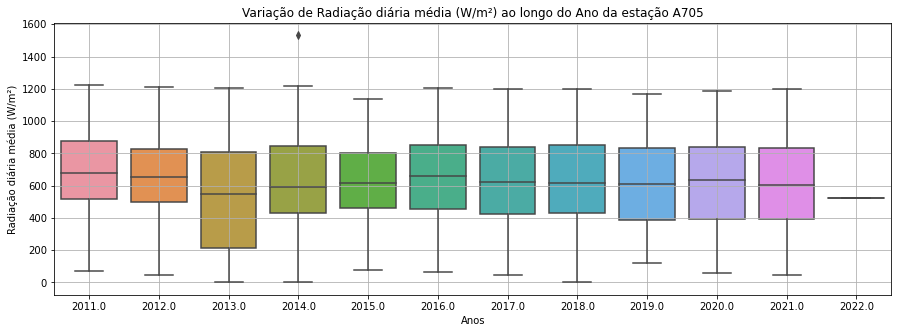

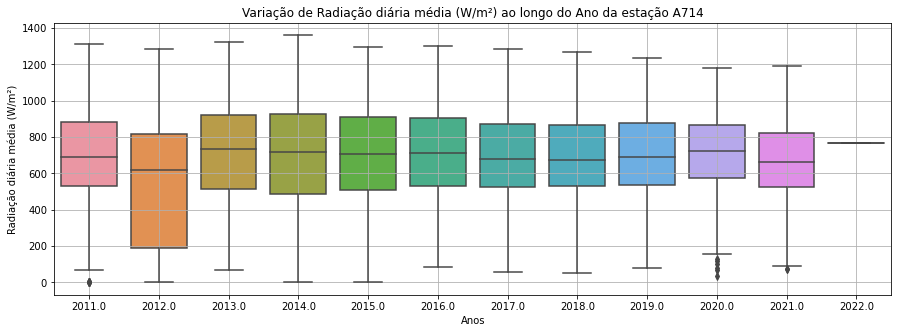

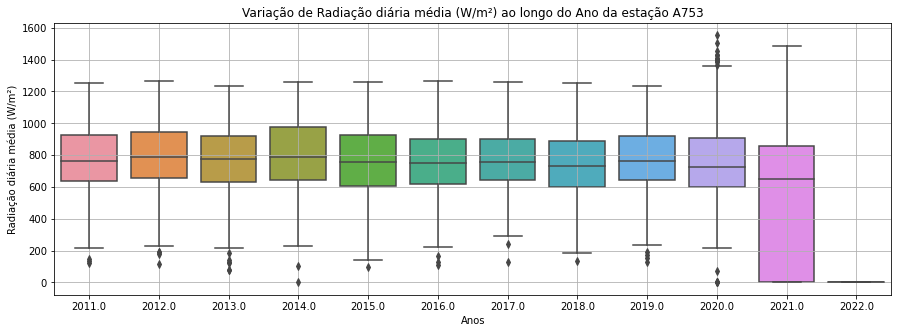

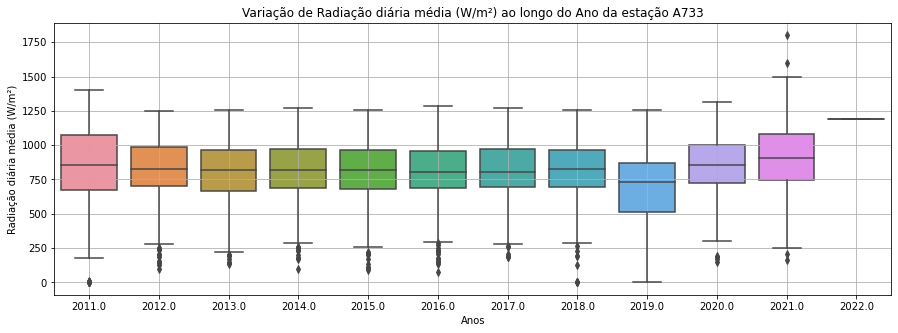

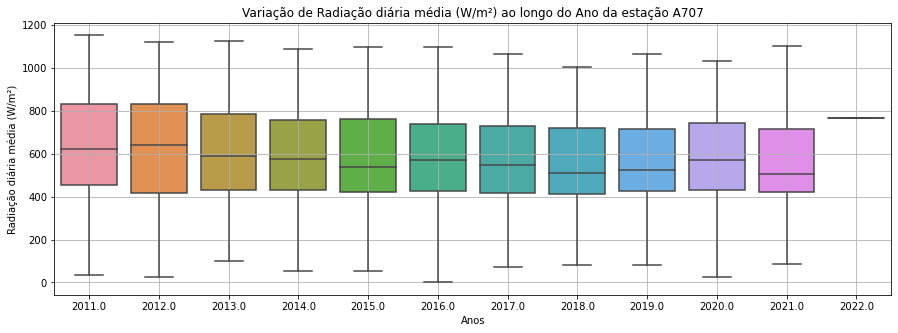

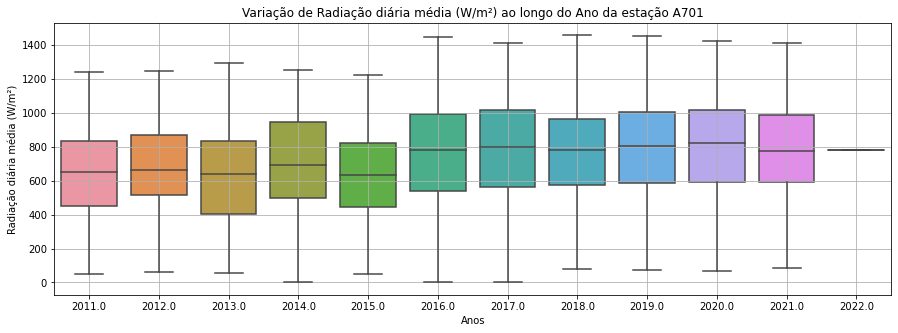

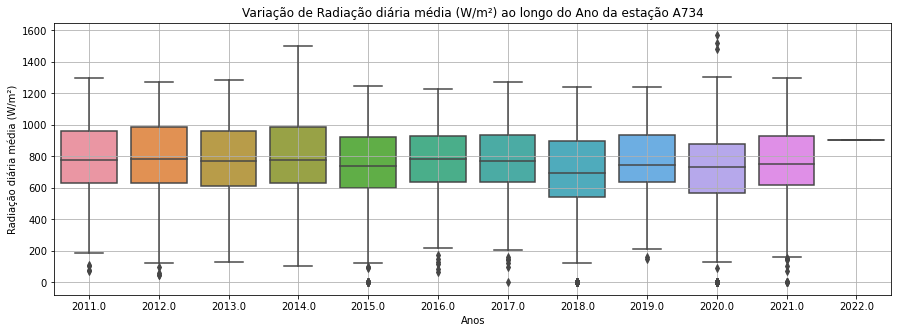

In [37]:
box_plot_for(df_dia_estacoes)

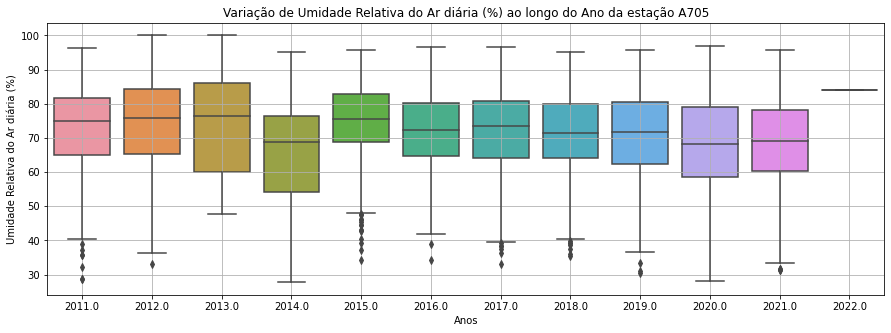

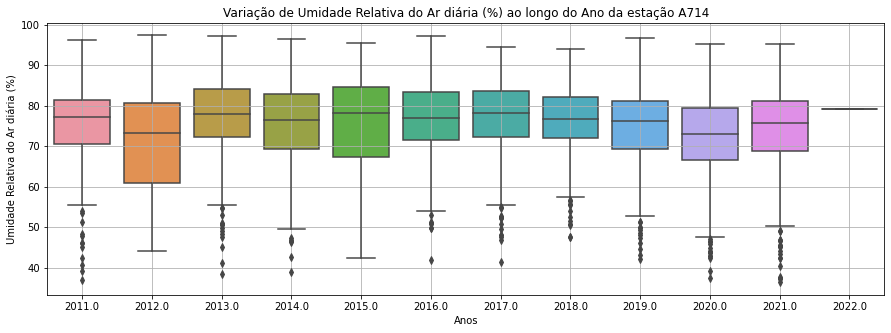

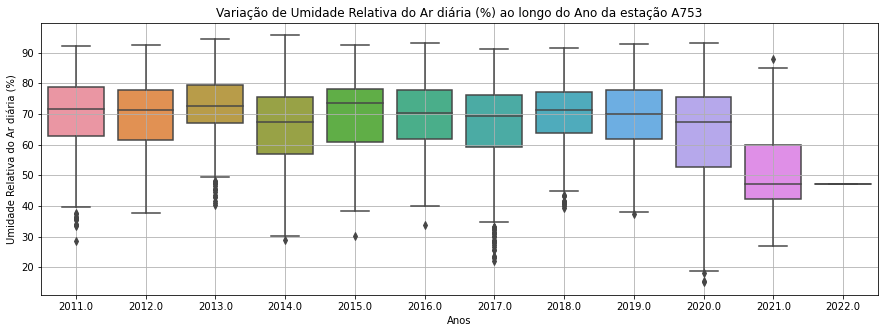

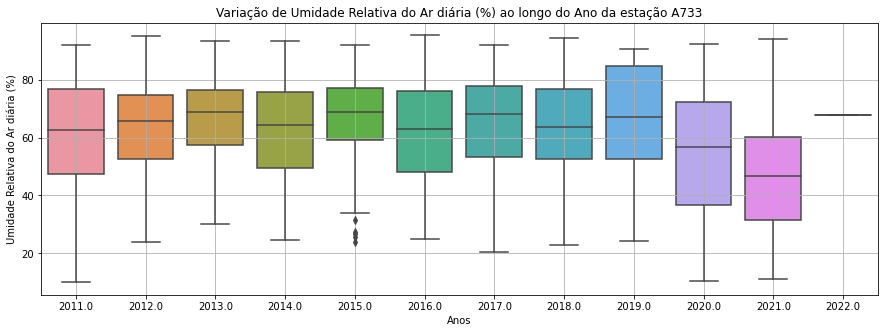

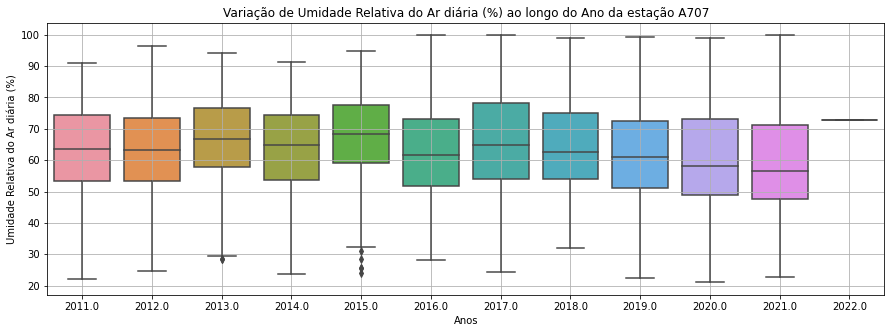

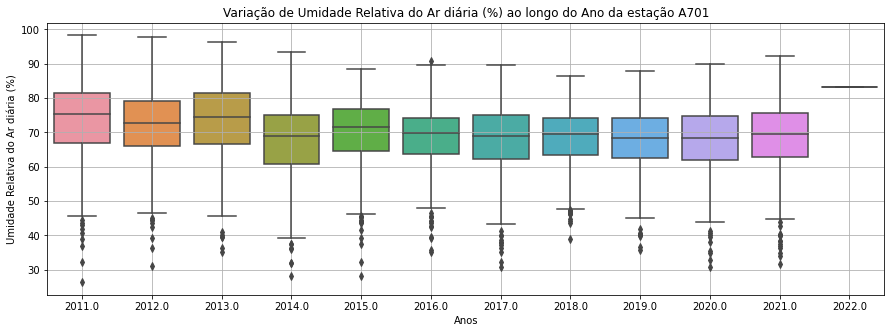

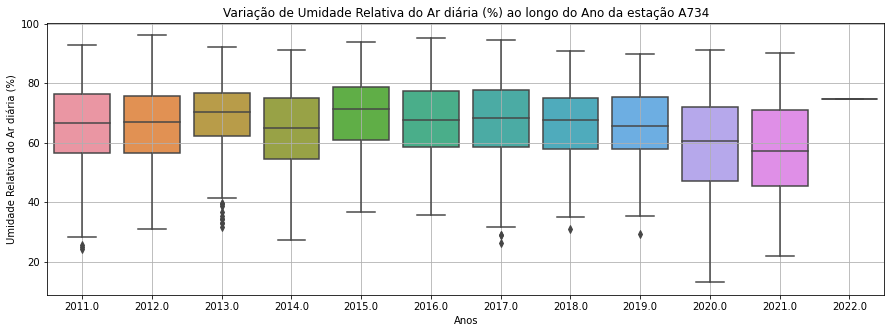

In [38]:
box_plot_for(data=df_dia_estacoes, y='UMD_INS', ylabel='Umidade Relativa do Ar diária (%)')  

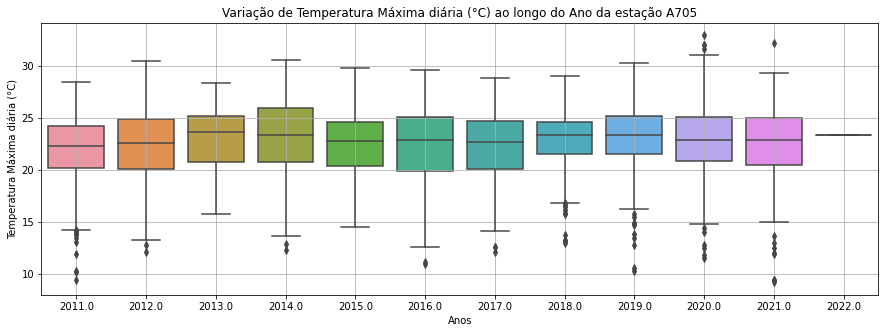

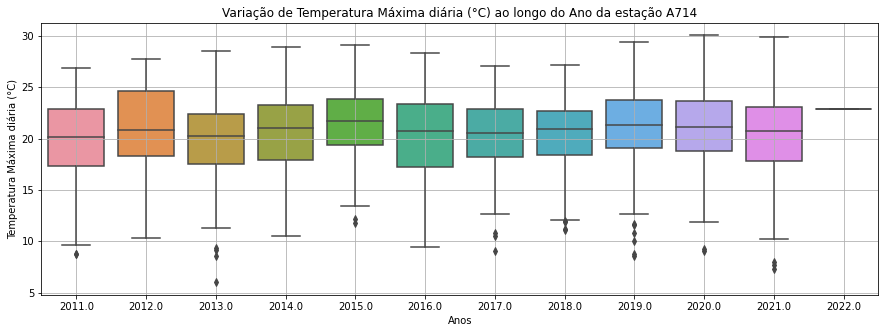

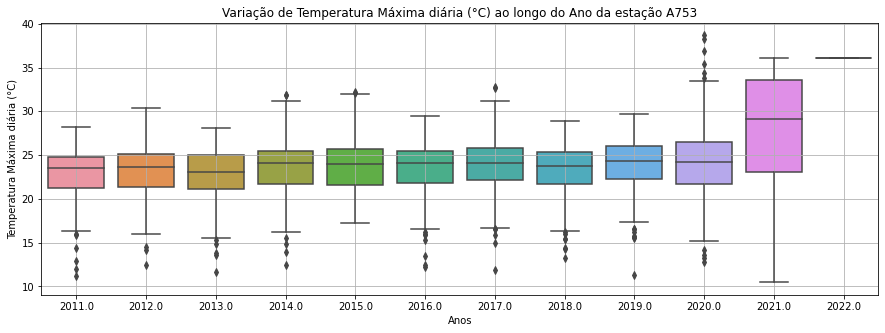

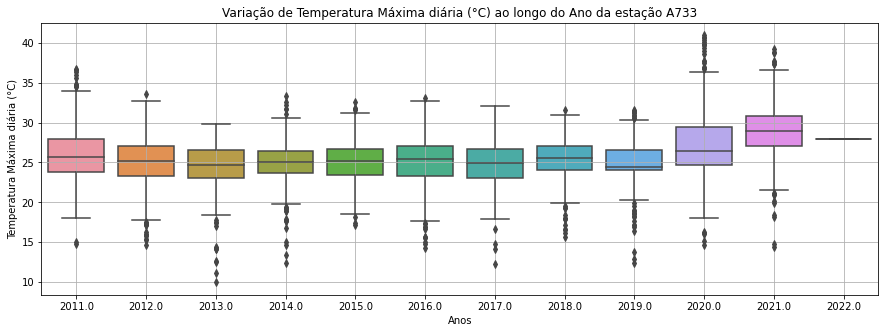

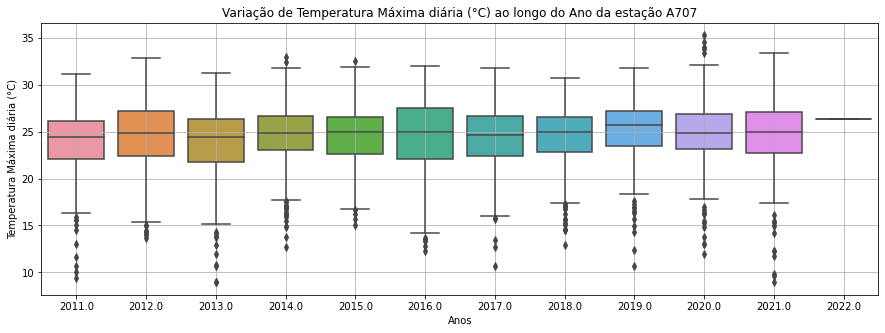

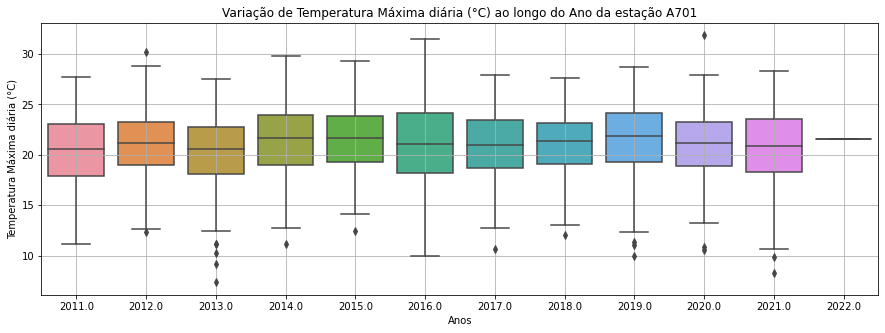

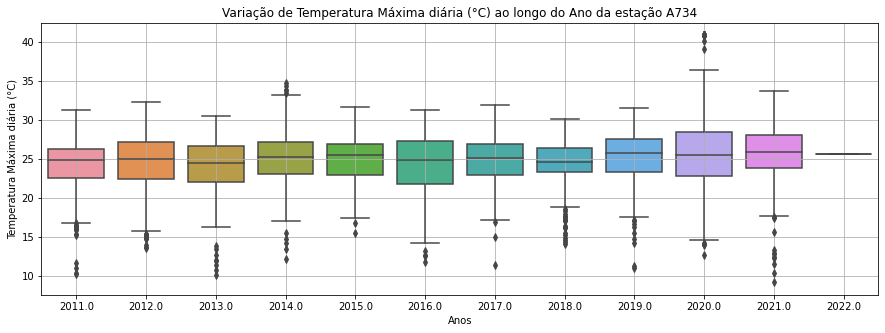

In [39]:
box_plot_for(data=df_dia_estacoes, y='TEM_MAX', ylabel='Temperatura Máxima diária (°C)')

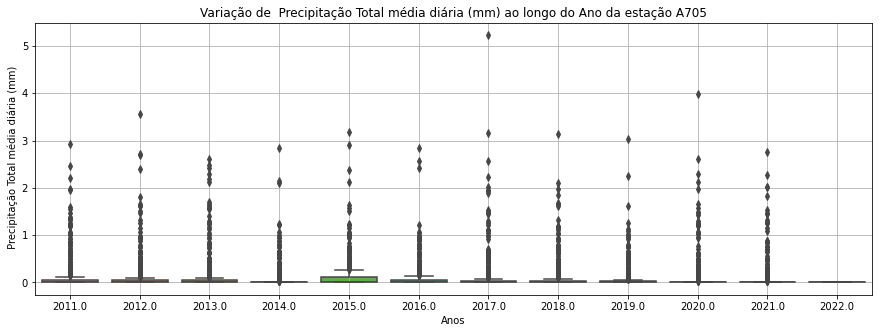

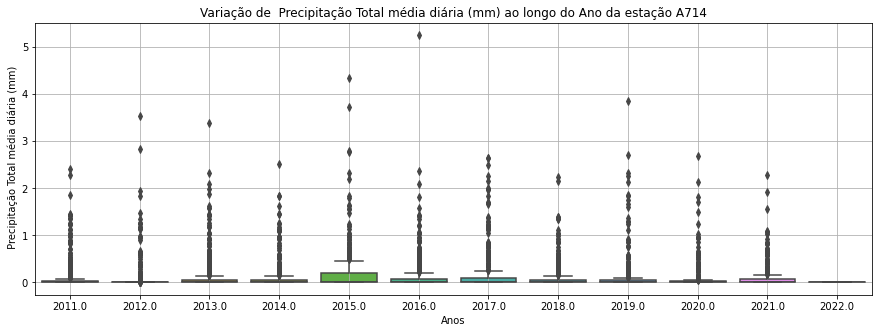

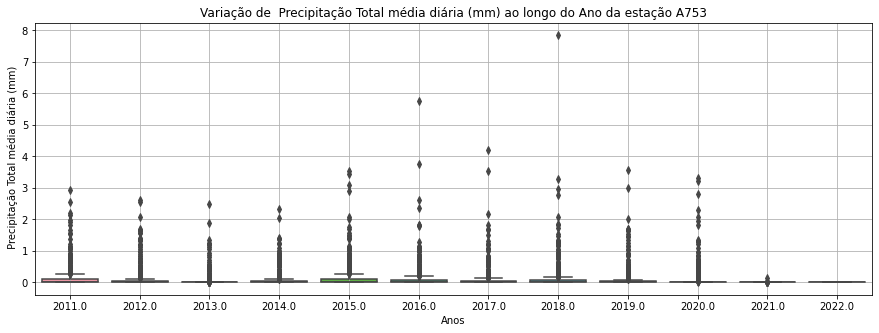

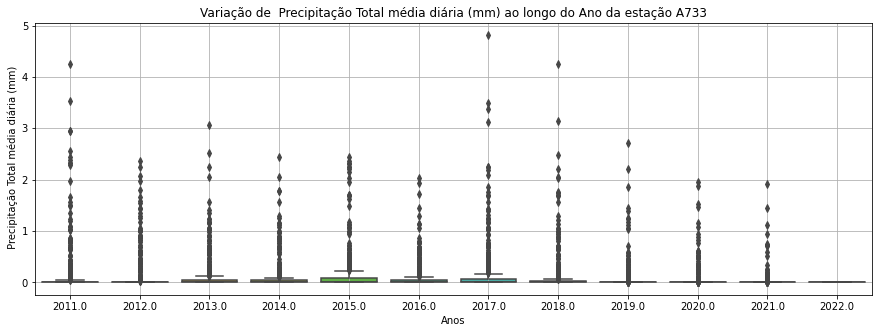

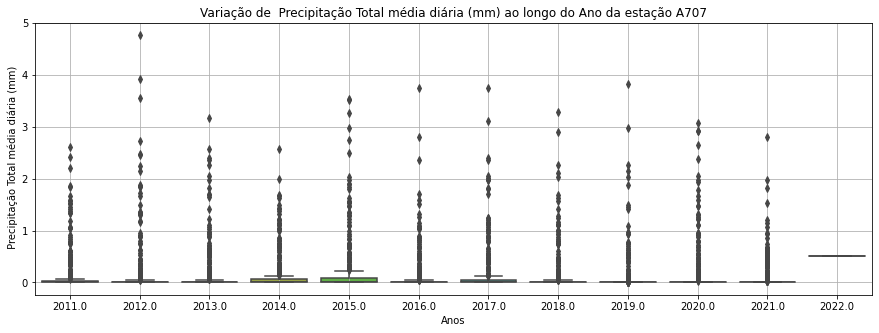

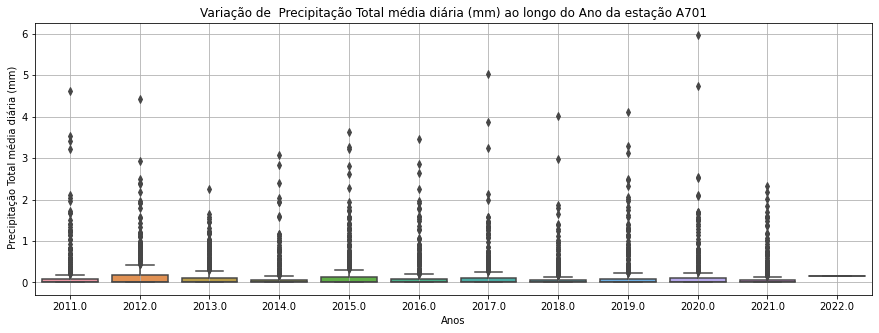

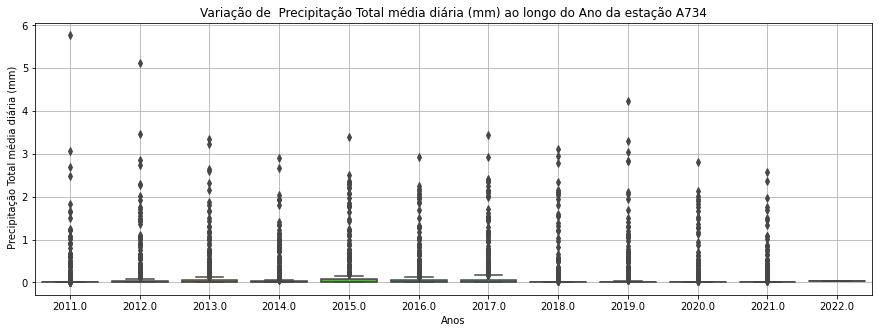

In [40]:
box_plot_for(data=df_dia_estacoes, y='CHUVA',ylabel=' Precipitação Total média diária (mm)')

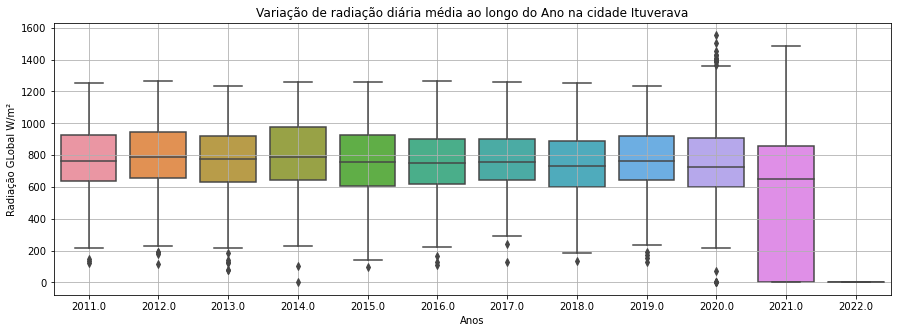

In [41]:
box_plot(df_dia_A753)

In [42]:
def graficos_subplot(df_dia ,ano_incial=2011,ano_final=2021):
    '''
    df_dia_(Estação);
    ano_incial = 2011
    ano_incial = 2021
    '''
    ## Para formatação das Legendas 
    name_city = df_dia['cidade'][0]
    name_estation = df_dia['estacao'][0]
    
    # Seleciona dias
    ano_incial = ano_incial
    ano_final = ano_final

    anos = range(ano_incial,ano_final,1)
    for ano in anos:
        df = df_dia.query(f'ANO == {ano}')

        fig, ax = plt.subplots(1, 2, figsize=(20, 6))

        ##  ------ RADIAÇÃO GLOBAL W/m²  ------------
        fig.suptitle(f'Gráficos da estação {name_estation} em {name_city} no ano {ano}')
        ax[0].plot(df['DT_MEDICAO'] , df['RAD'],'o-')
        ax[0].set_xlabel('Data da medição[dia]',fontsize= 15)
        ax[0].set_ylabel('Radiação[W/m²]',fontsize=16)
        ax[0].axhline(df['RAD'].mean(),c = 'red',label='Radiação_média')
        ax[0].grid(True, 'both','both')
        ax[0].set_title(f'Radiação global diária média[W/m²] durante o ano {ano}')
        ax[0].set_xticks(df.iloc[range(0,df.shape[0],10),0])
        ax[0].tick_params(axis='x', rotation=90)
        ax[0].legend(fontsize=15);

        ##  ------ 'TEM_MAX': TEMPERATURA MÁXIMA NA HORA ANT. °C,  ------------
        ax[1].plot(df['DT_MEDICAO'] , df['TEM_MAX'],'o-',color = 'black')
        ax[1].set_title(f'Temperatura[°C] média diária durante o ano {ano}')
        ax[1].set_xlabel('Data da medição[dia]',fontsize= 15)
        ax[1].set_ylabel('Temperatura[°C]',fontsize=16)
        ax[1].axhline(df['TEM_MAX'].mean(),c = 'red',label='TMax_média')
        ax[1].grid(True, 'both','both')
        ax[1].set_xticks(df.iloc[range(0,df.shape[0],10),0])
        ax[1].tick_params(axis='x', rotation=90)        
        ax[1].legend(fontsize=15);

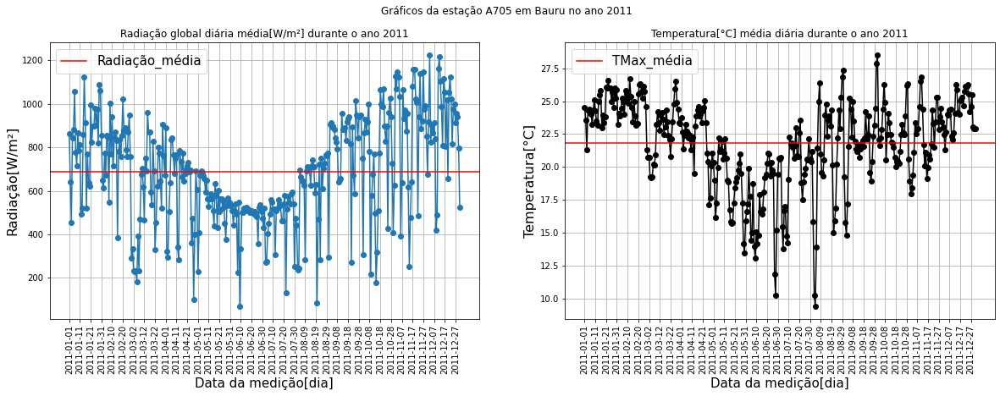

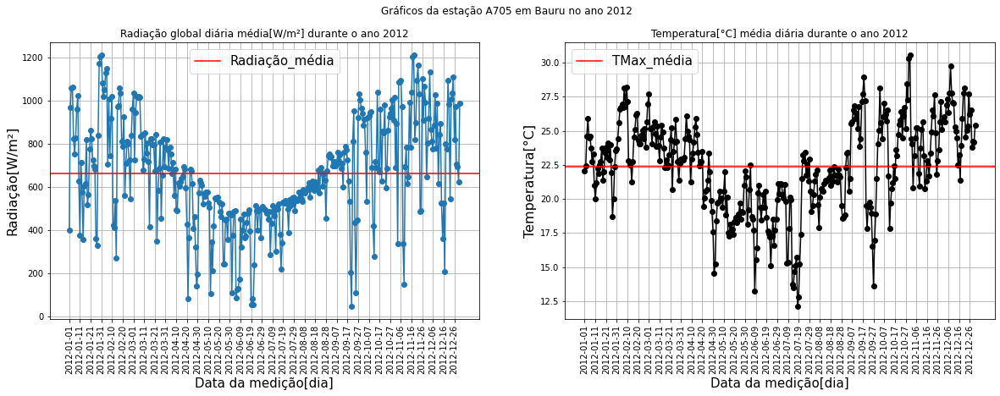

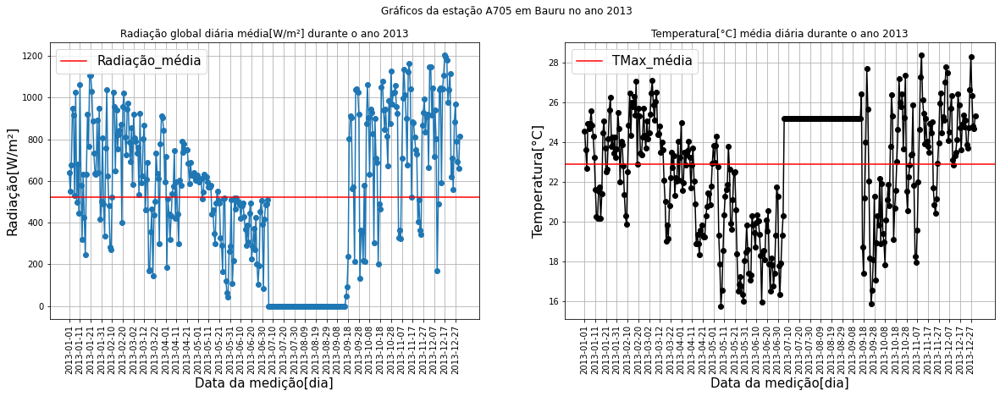

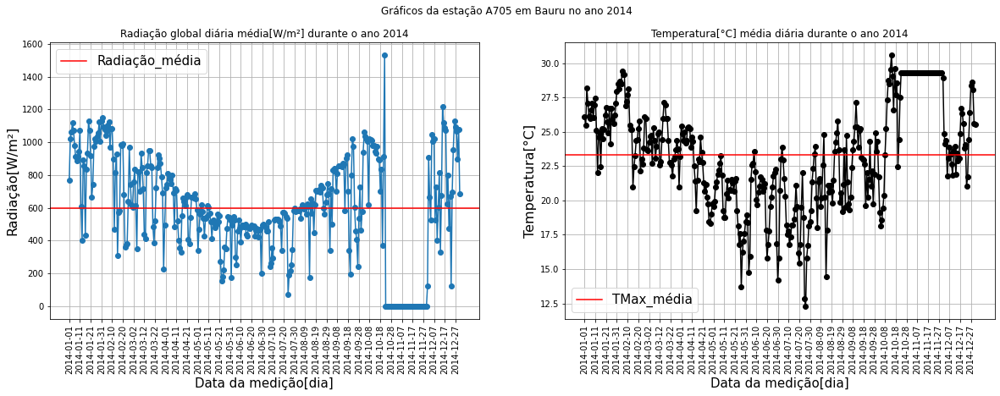

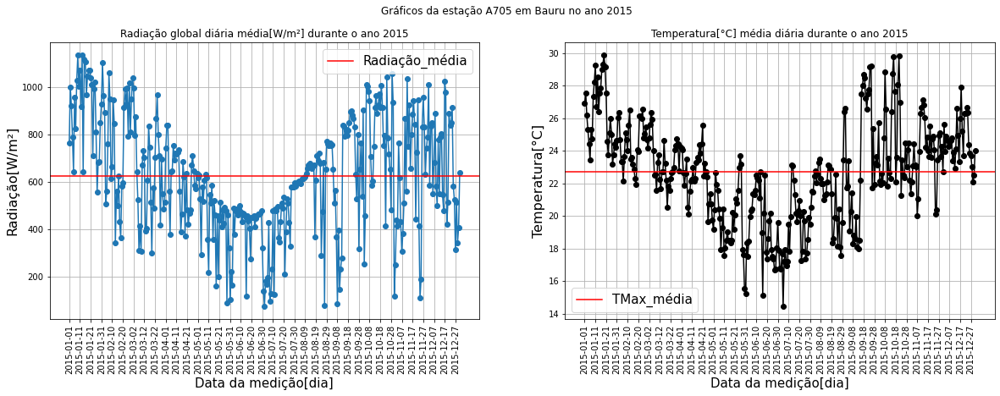

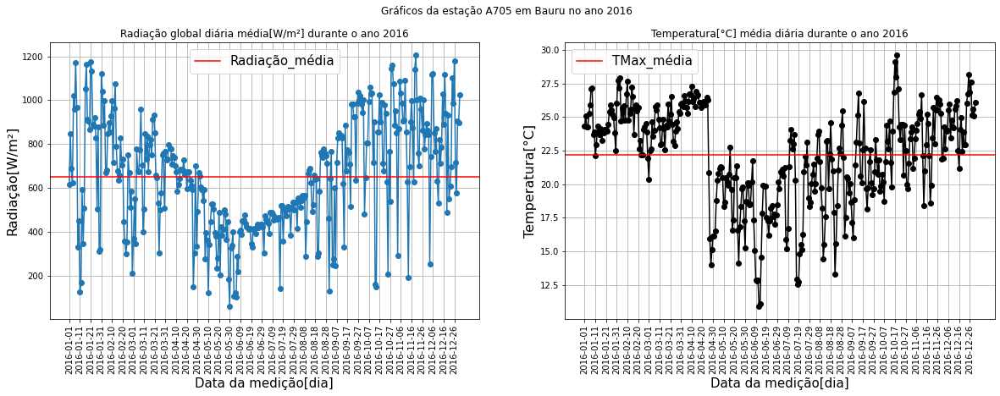

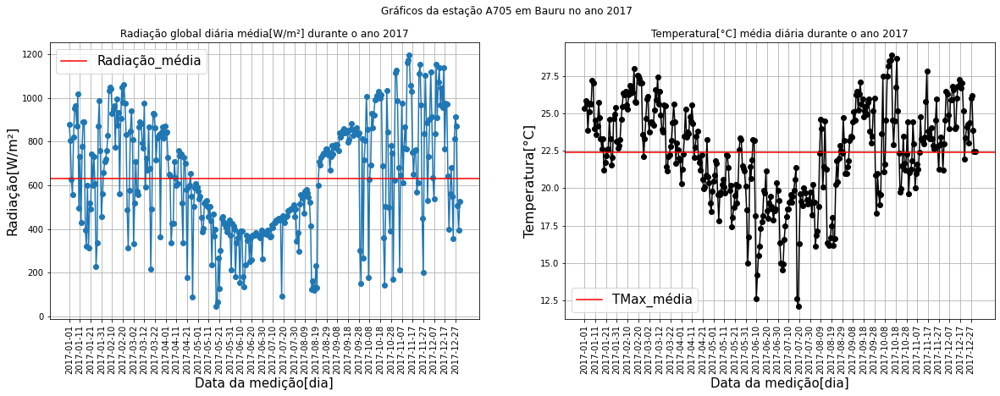

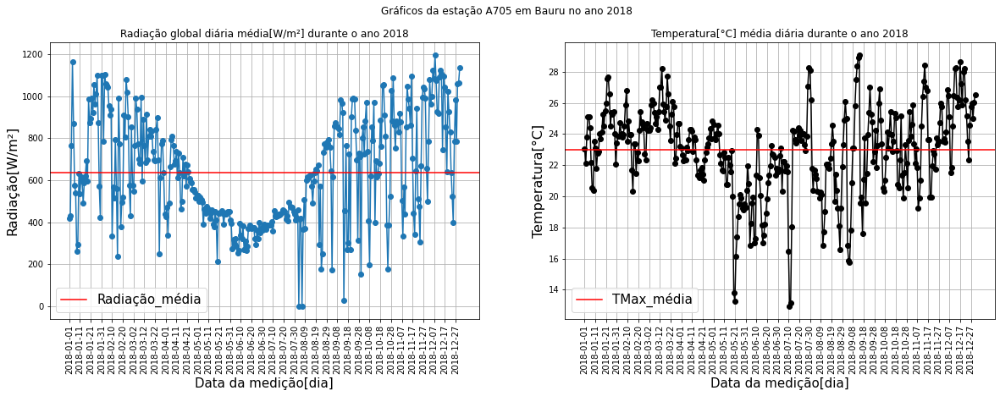

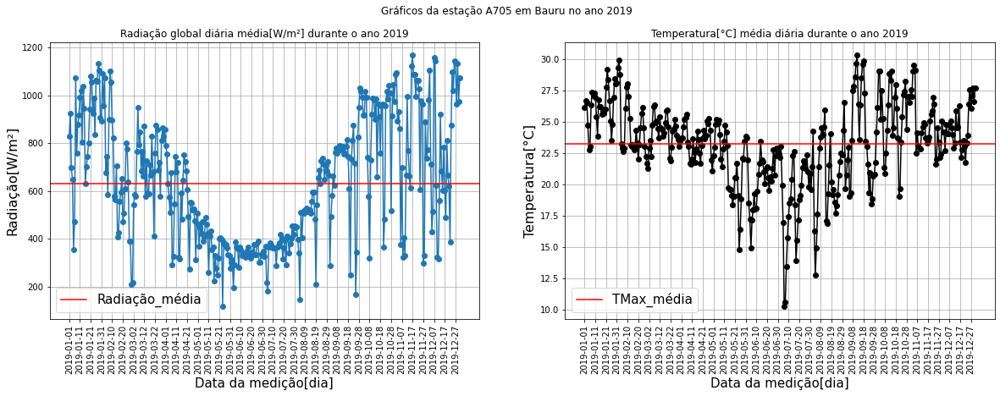

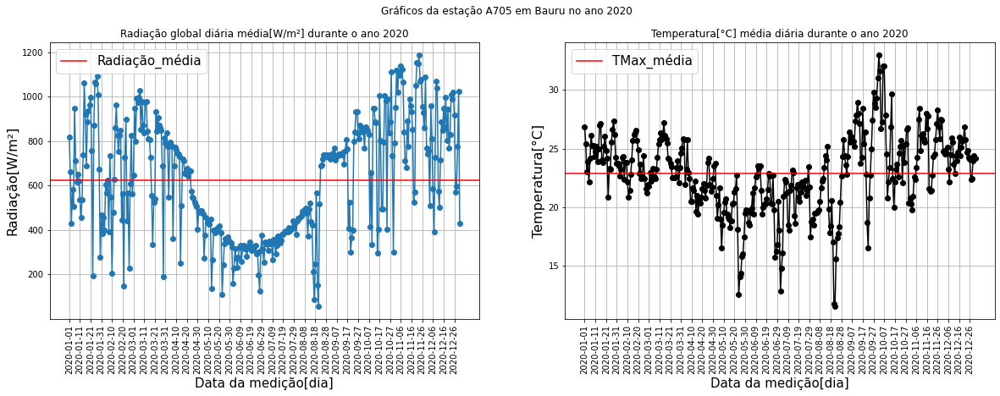

In [43]:
graficos_subplot(df_dia_A705)

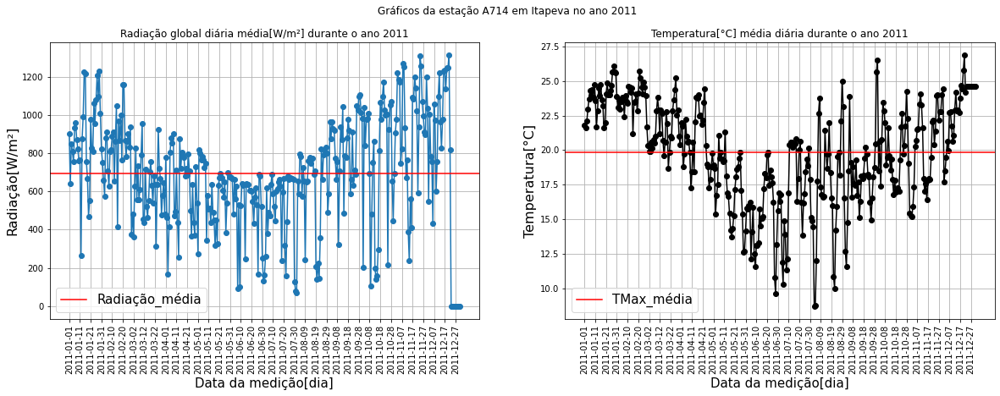

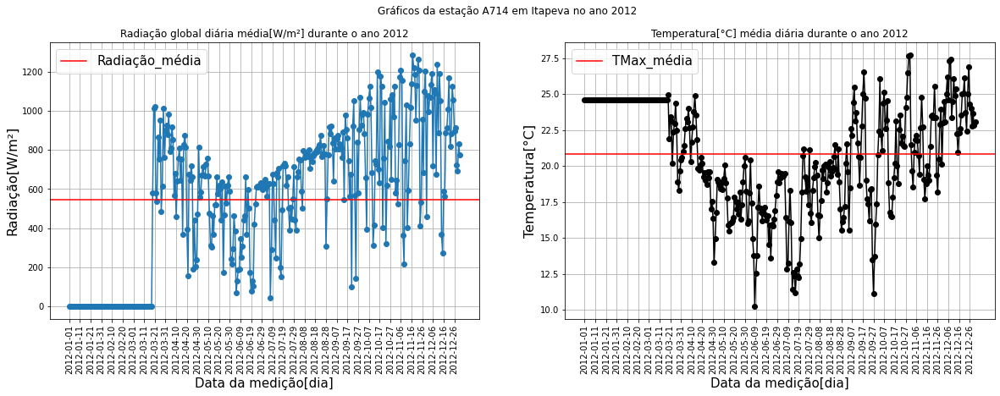

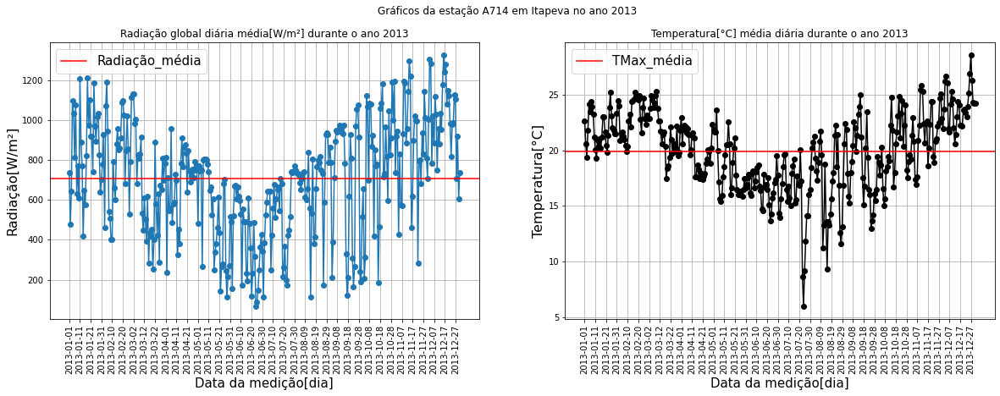

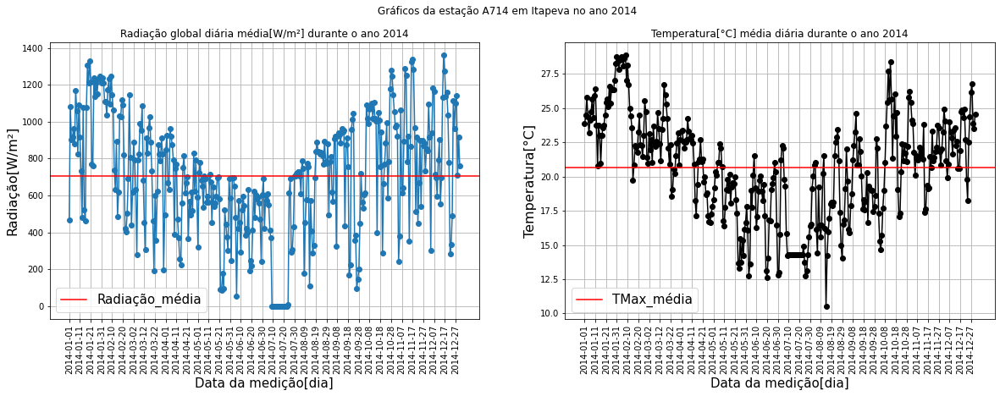

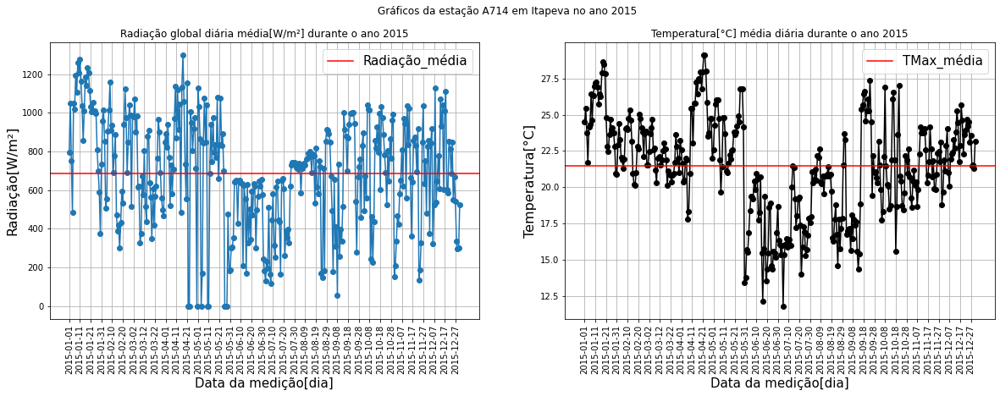

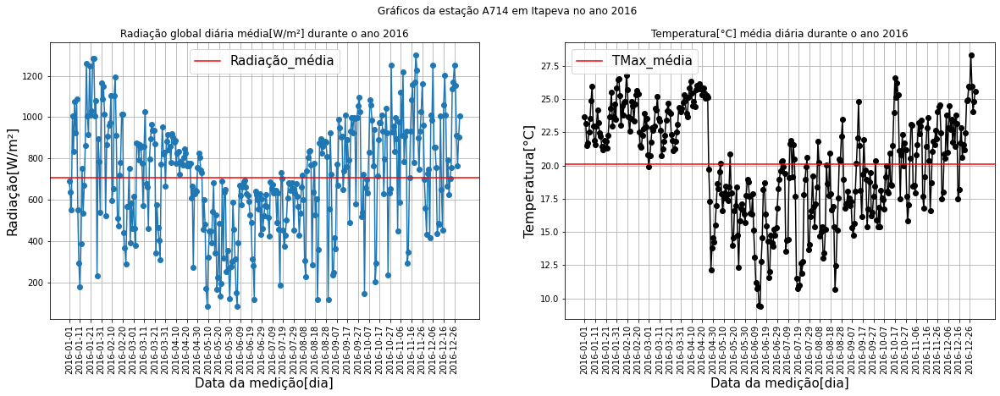

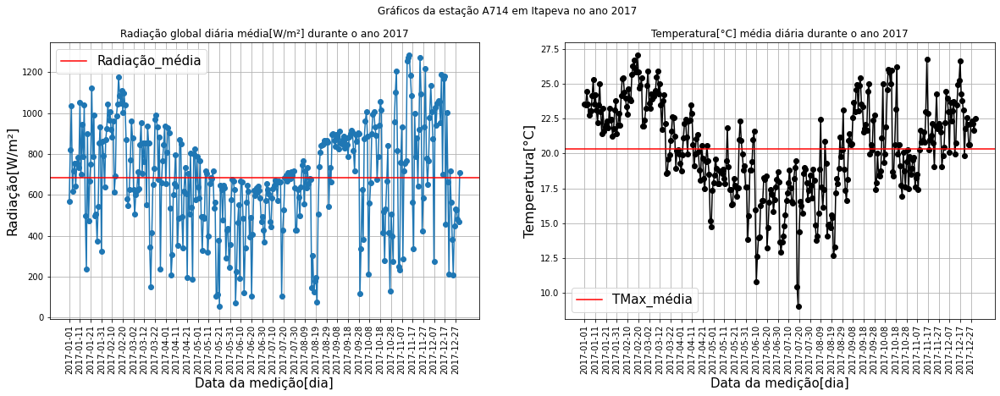

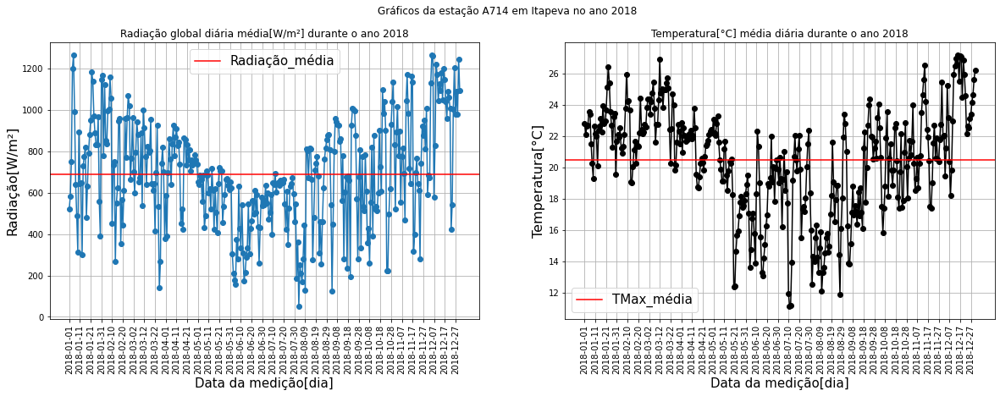

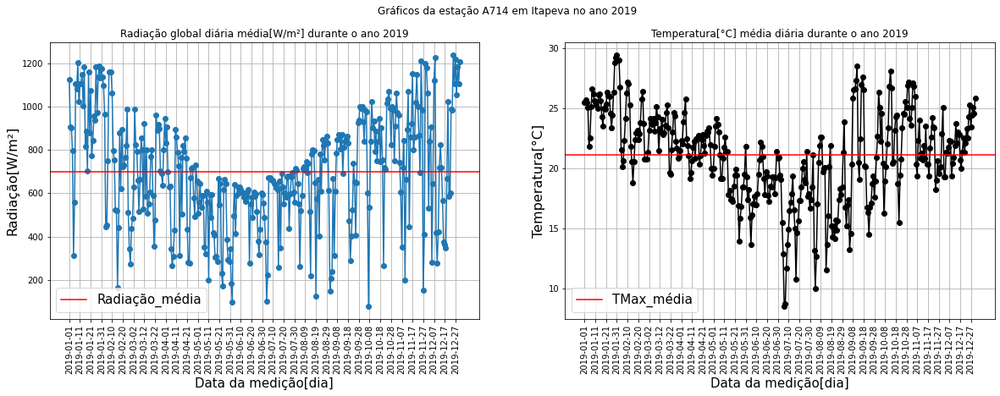

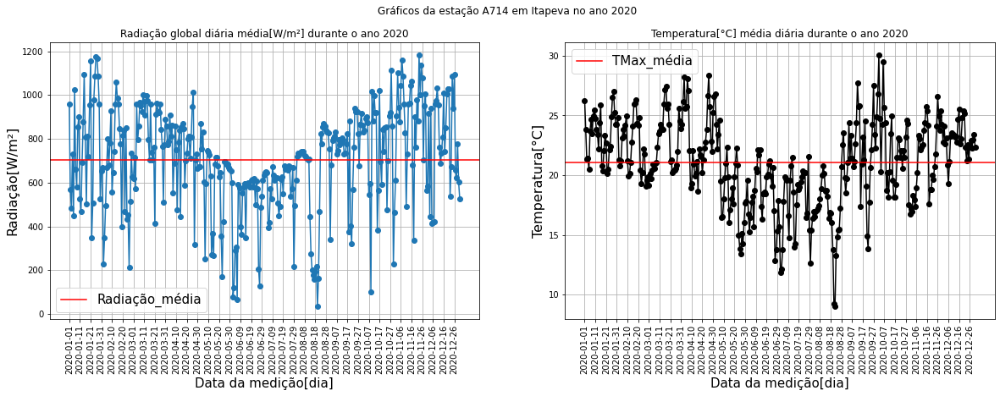

In [44]:
graficos_subplot(df_dia_A714)

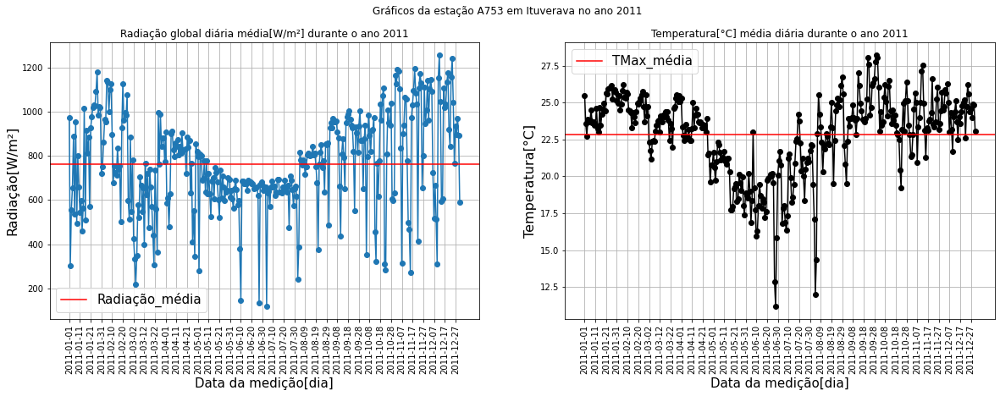

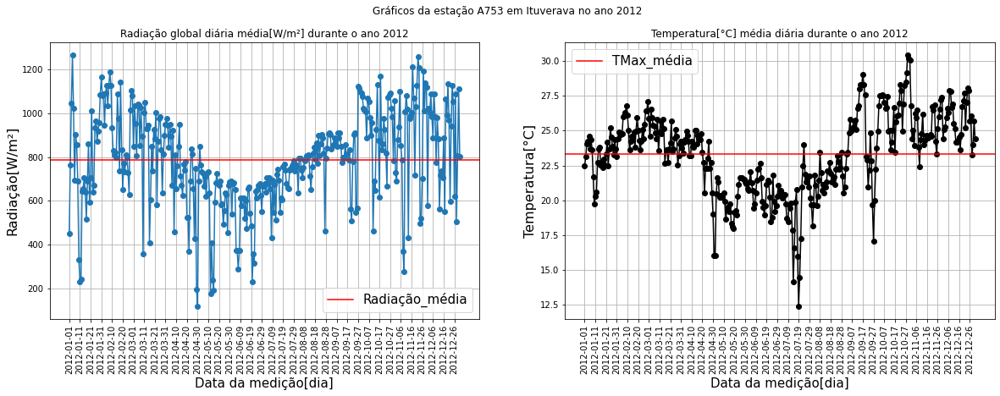

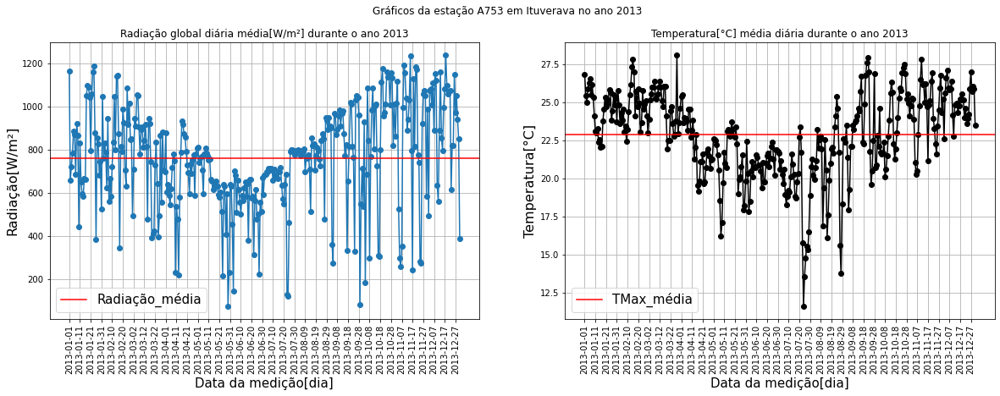

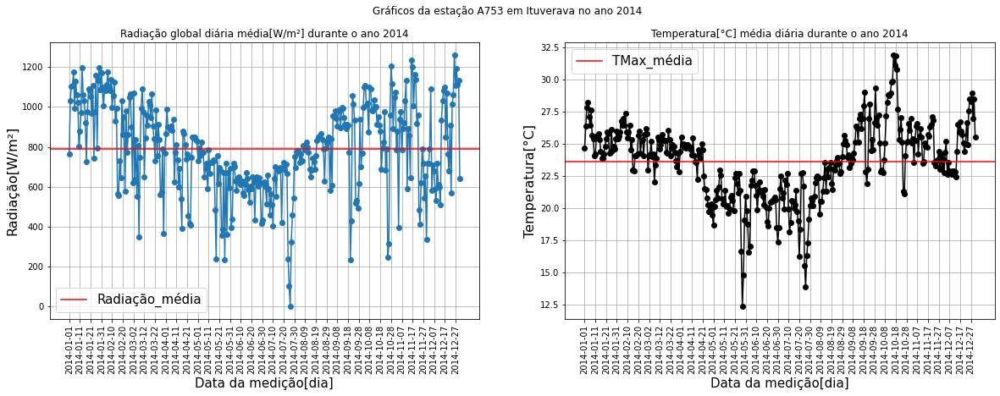

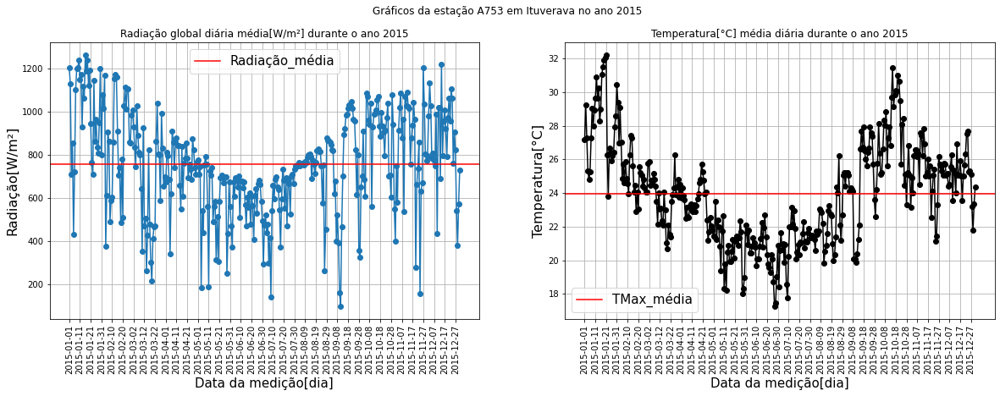

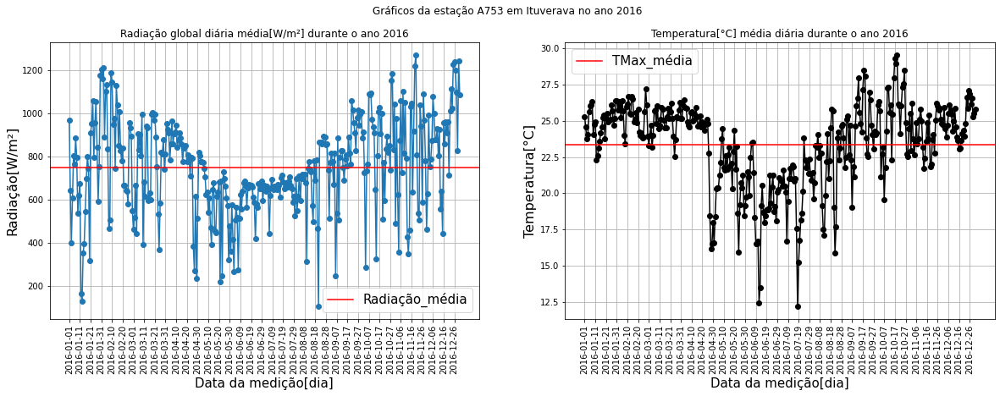

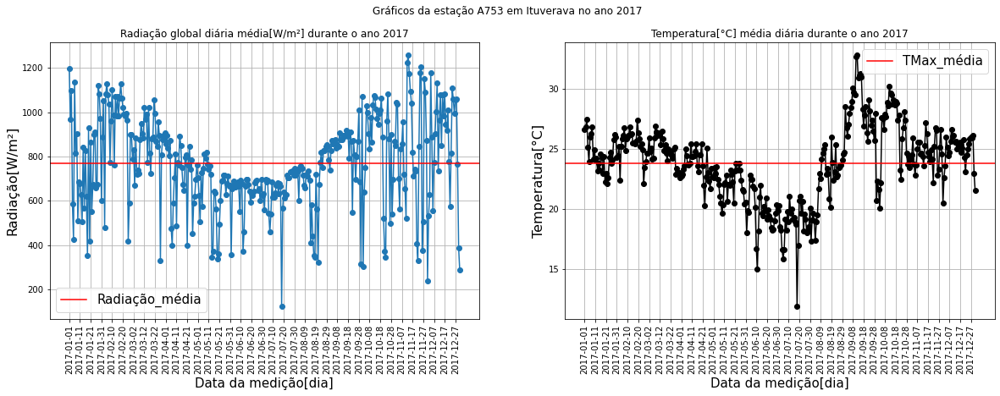

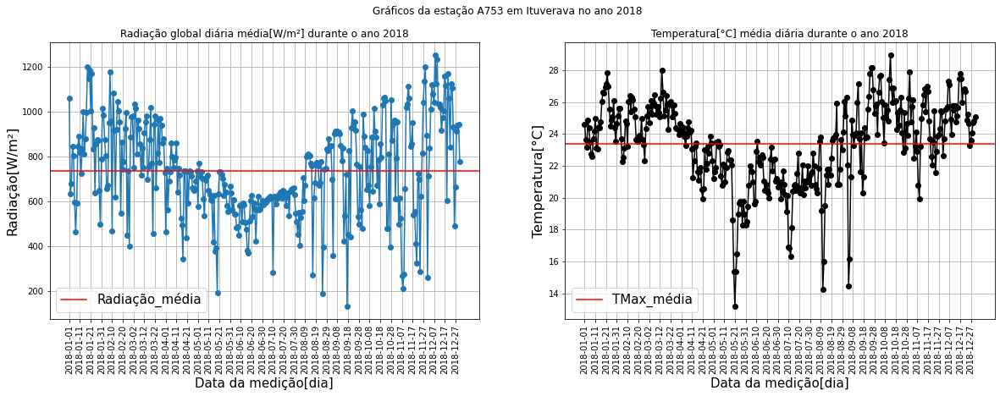

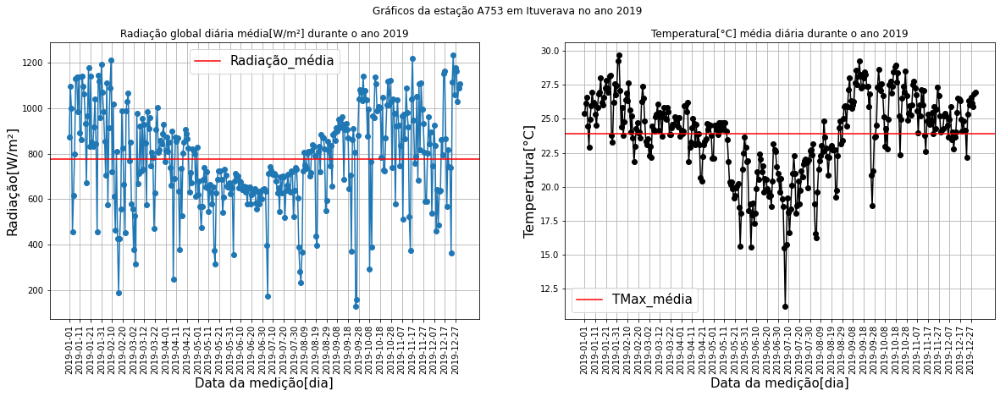

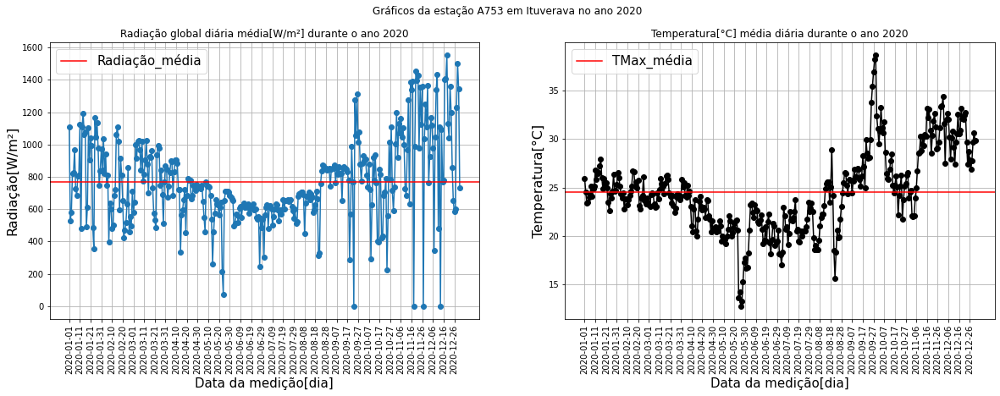

In [45]:
graficos_subplot(df_dia_A753)

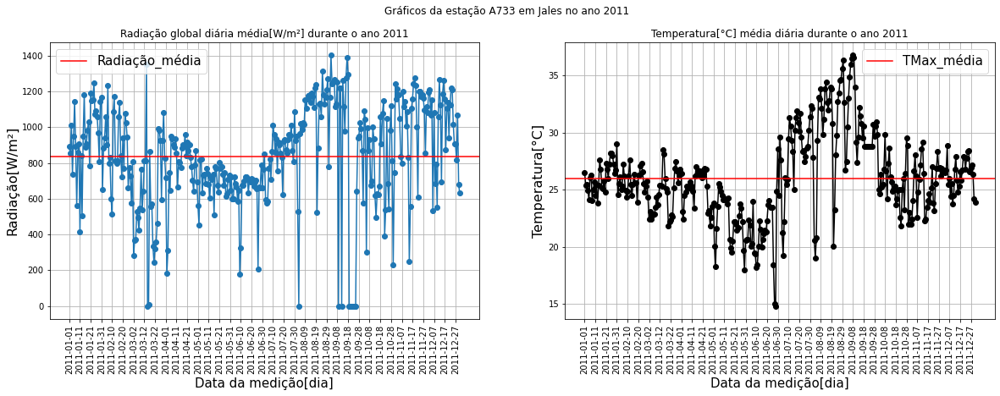

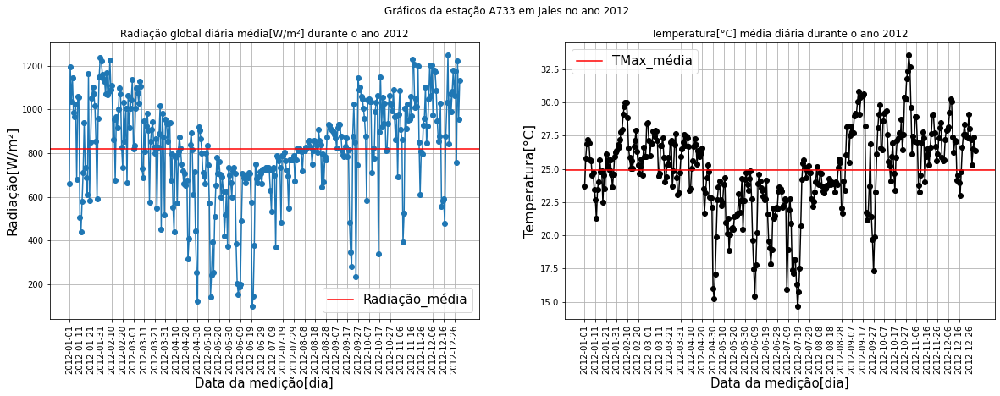

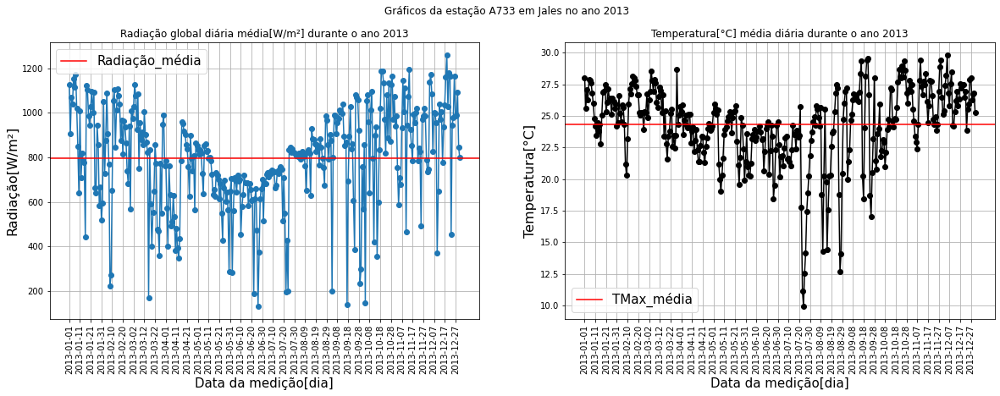

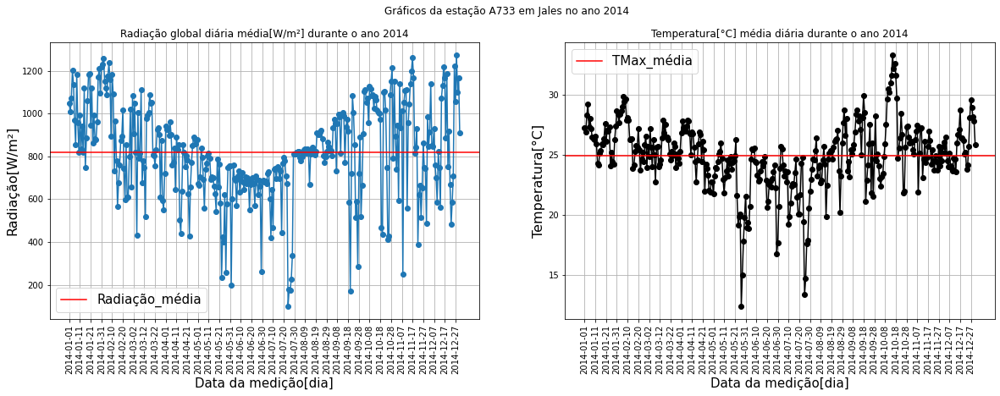

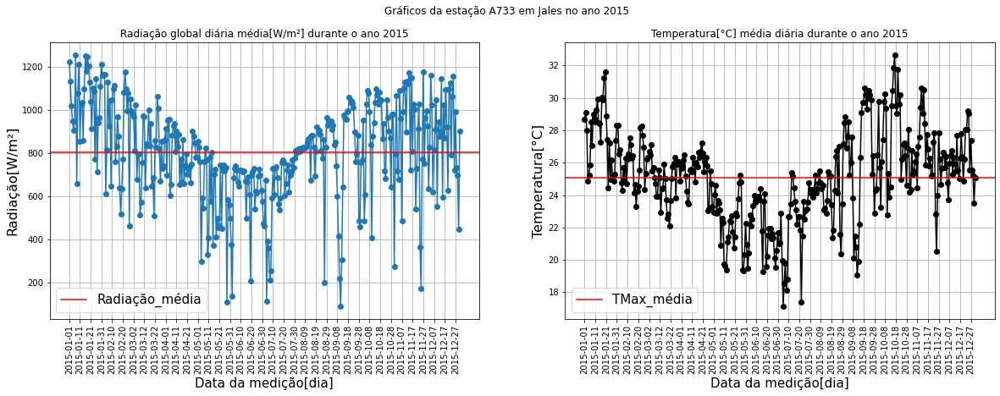

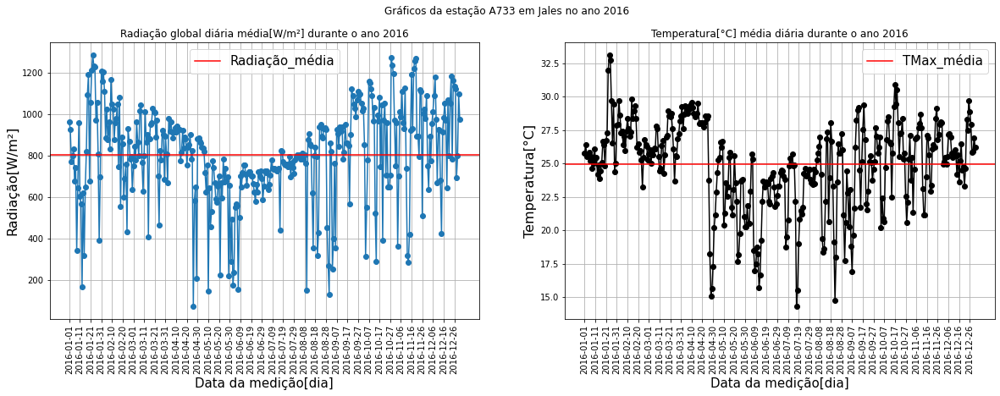

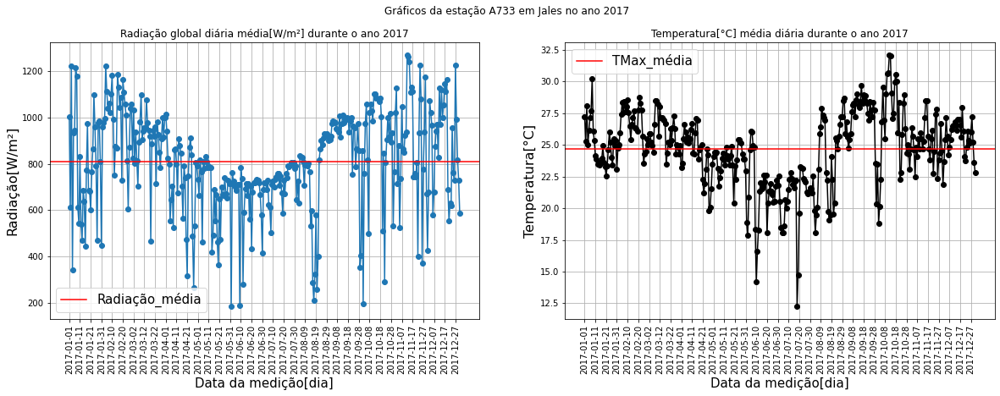

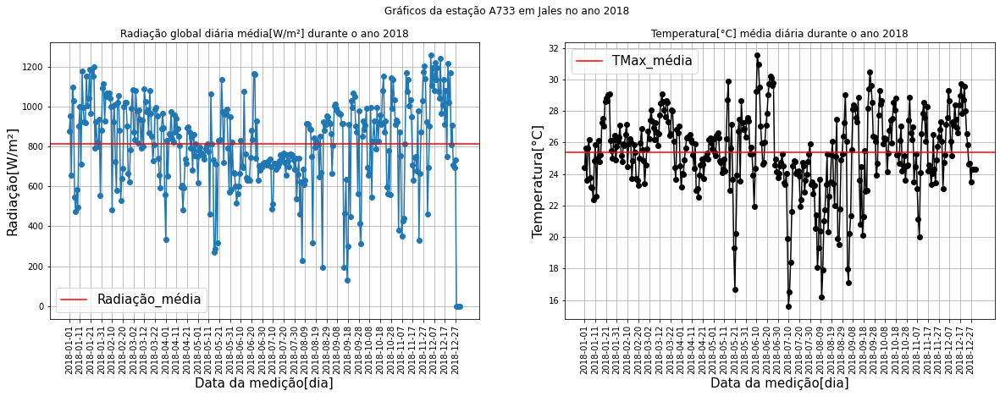

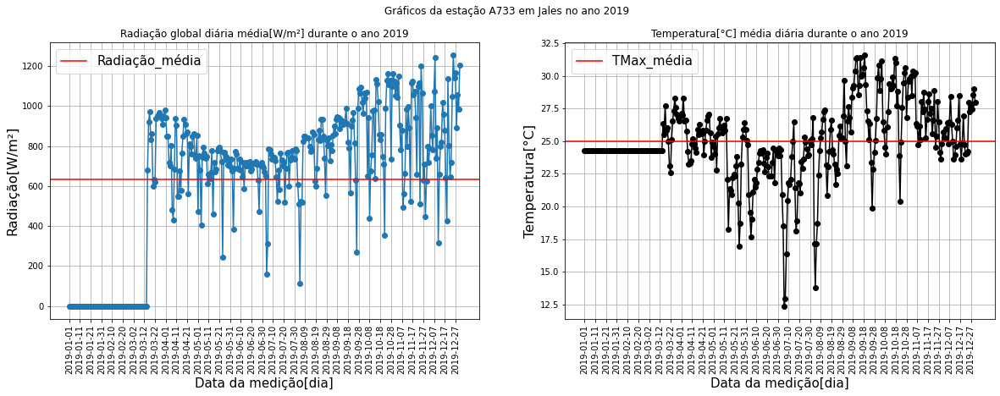

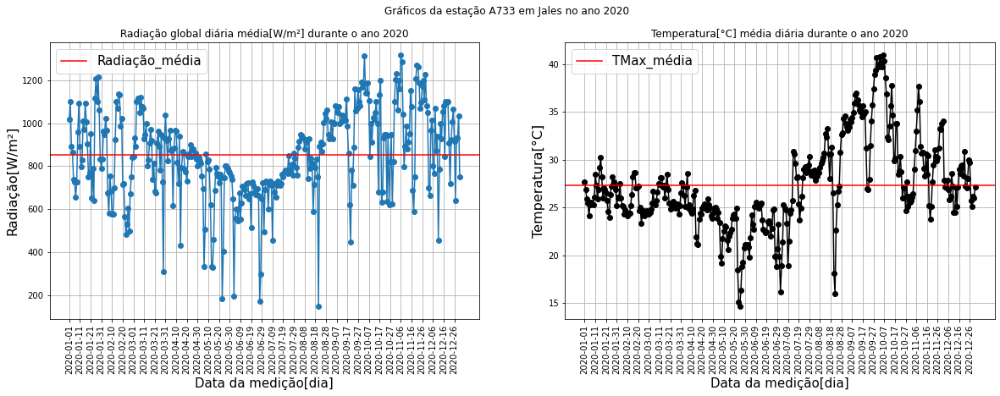

In [46]:
graficos_subplot(df_dia_A733)

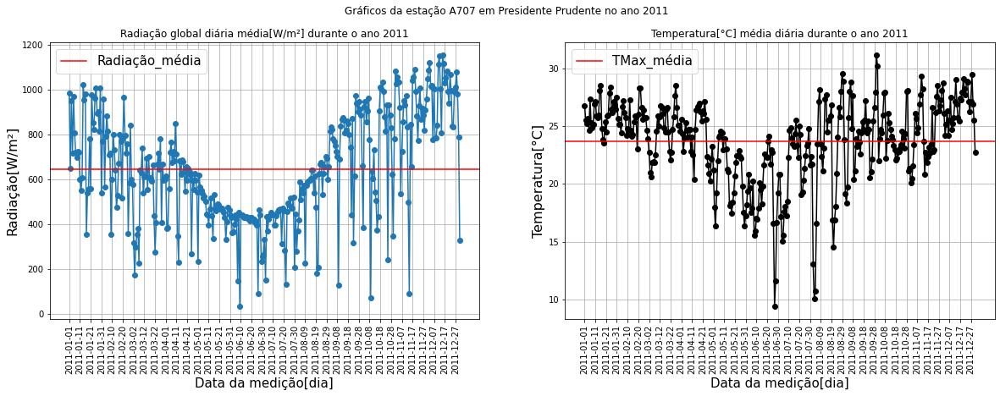

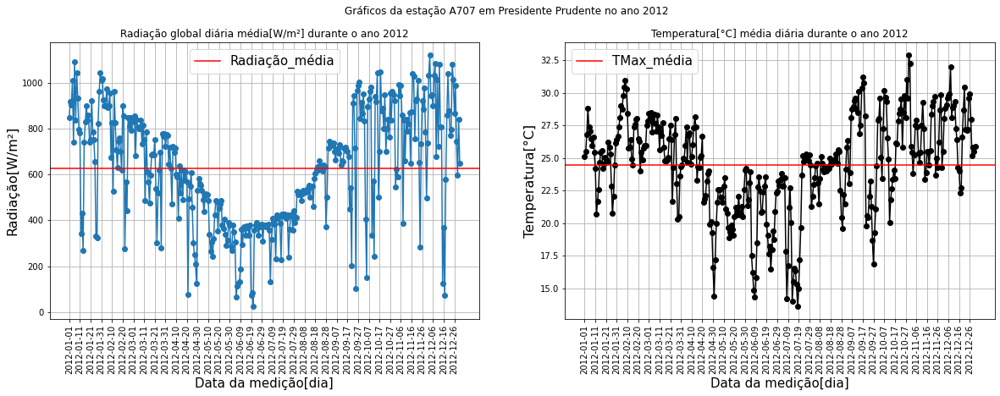

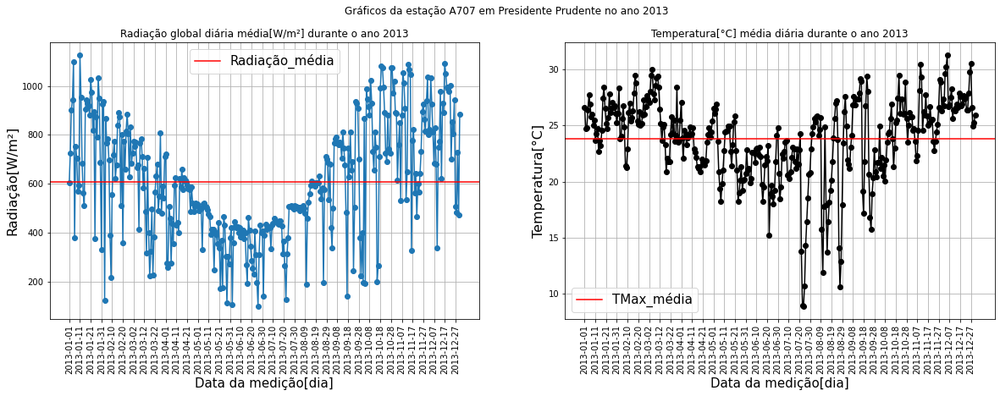

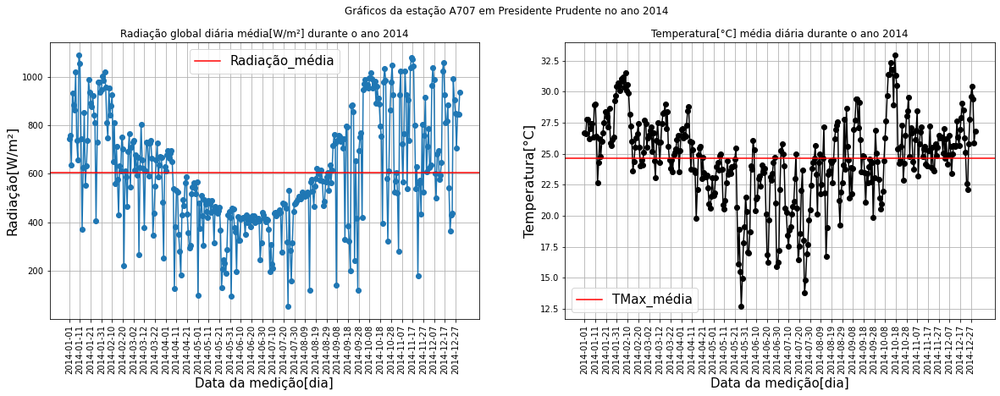

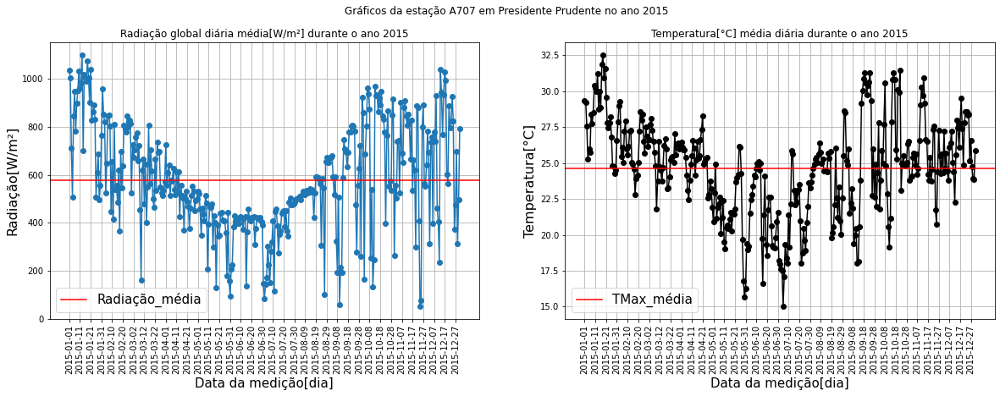

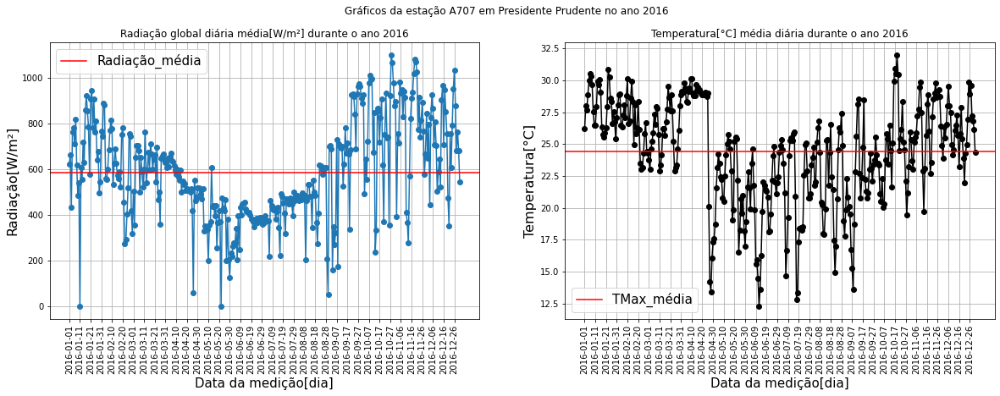

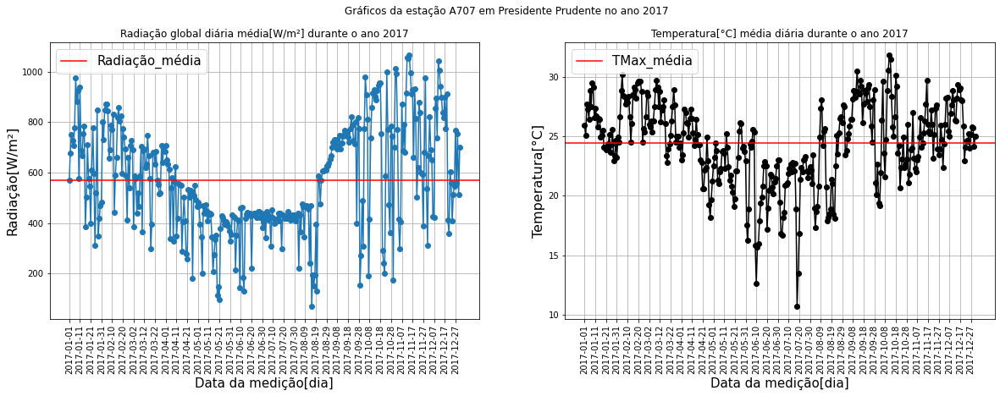

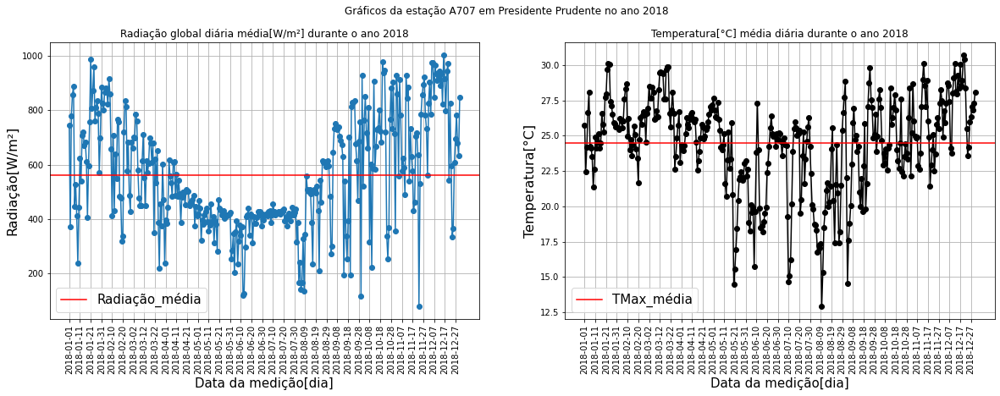

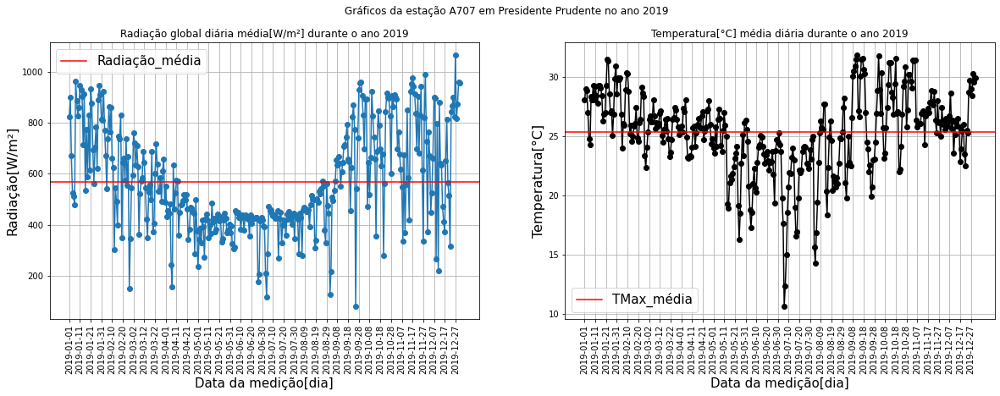

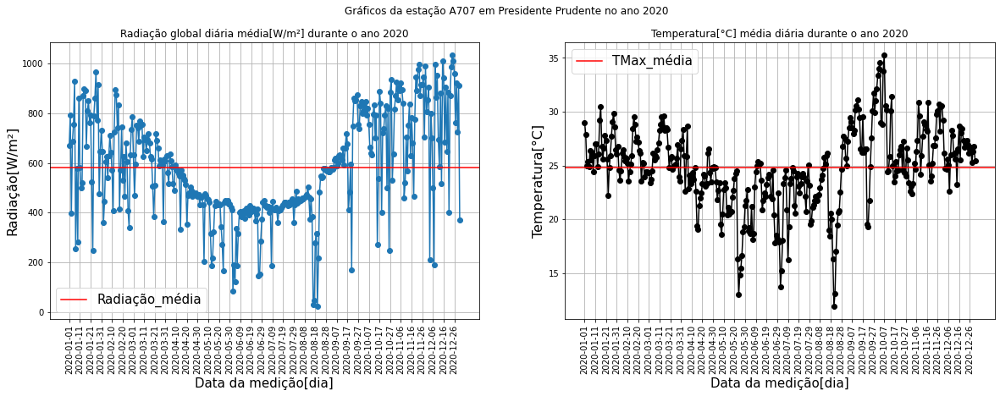

In [47]:
graficos_subplot(df_dia_A707)

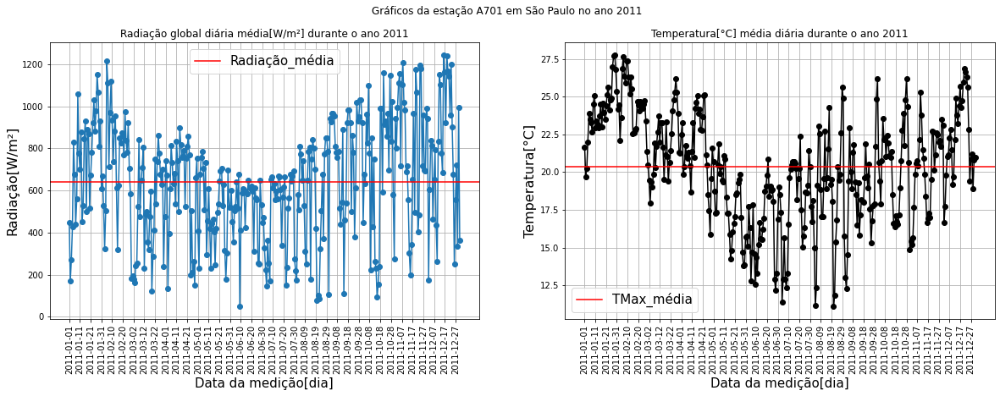

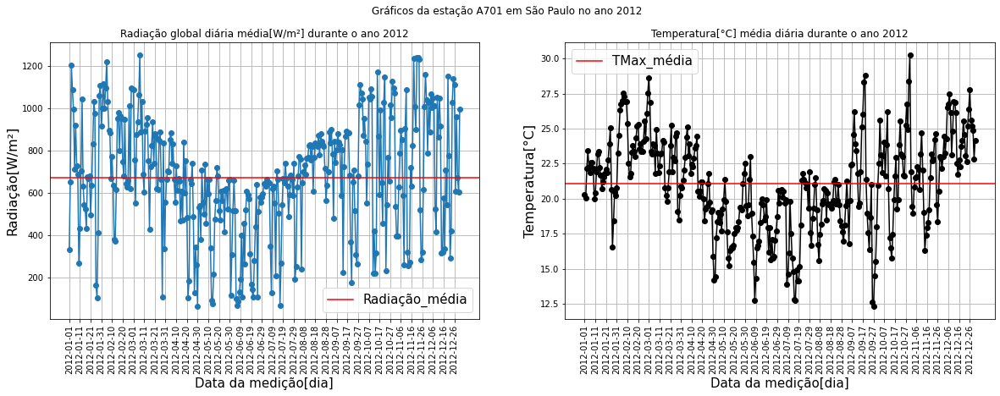

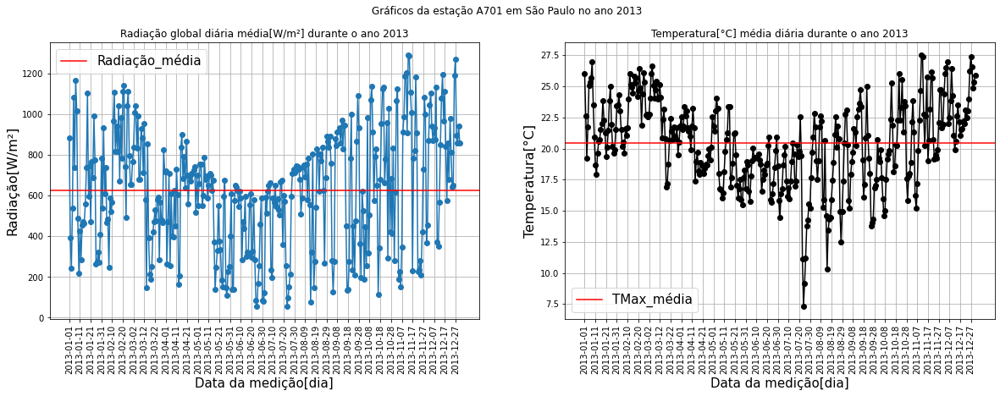

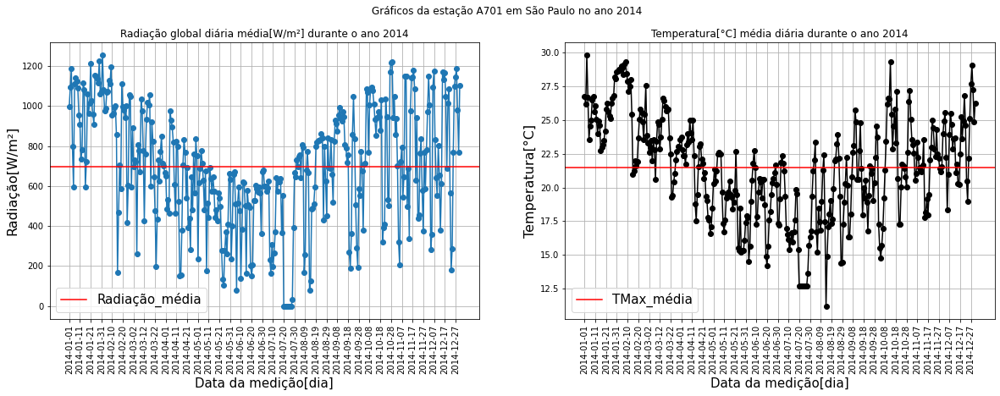

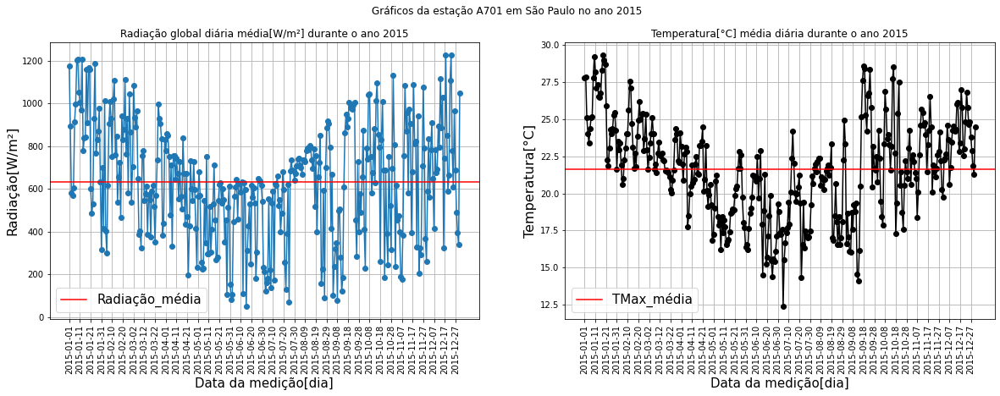

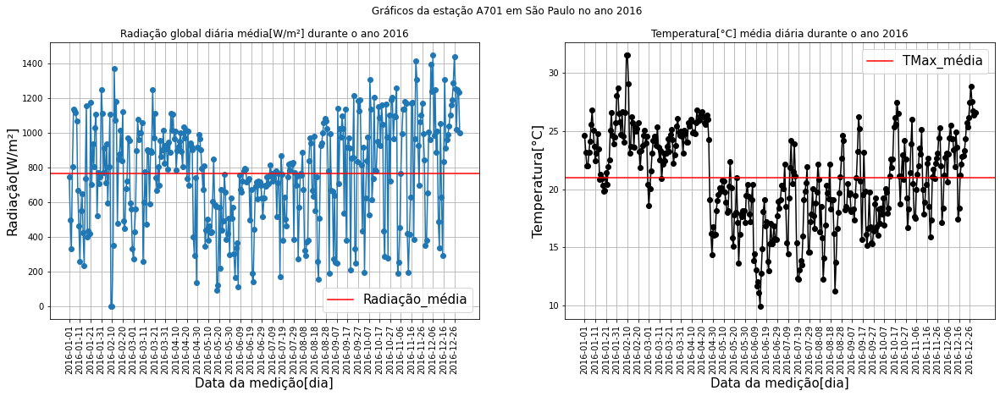

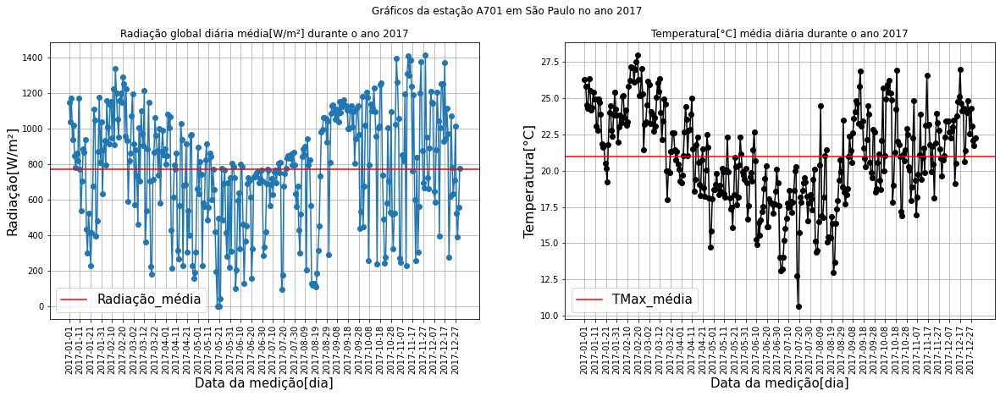

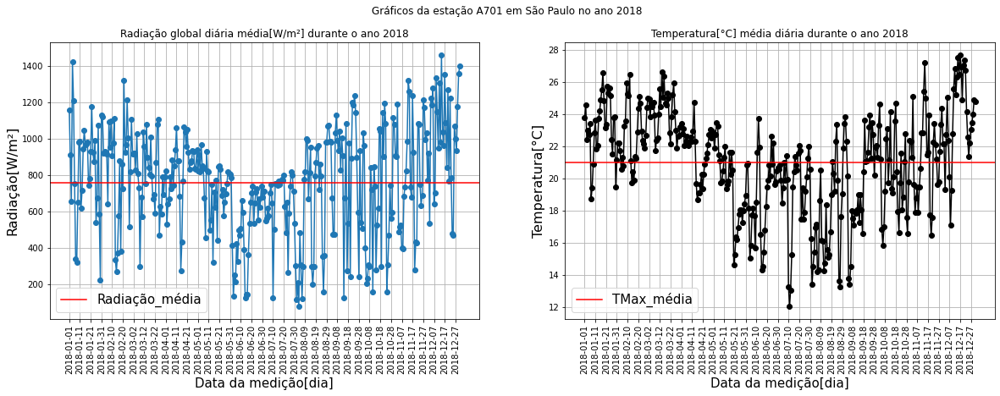

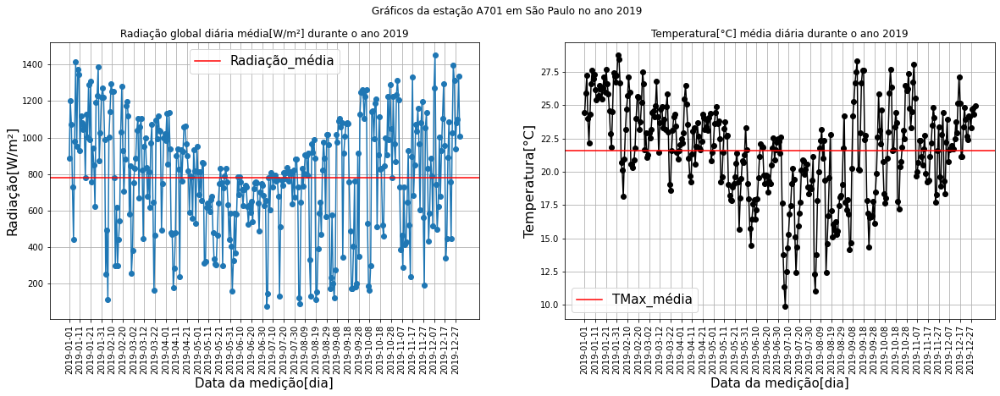

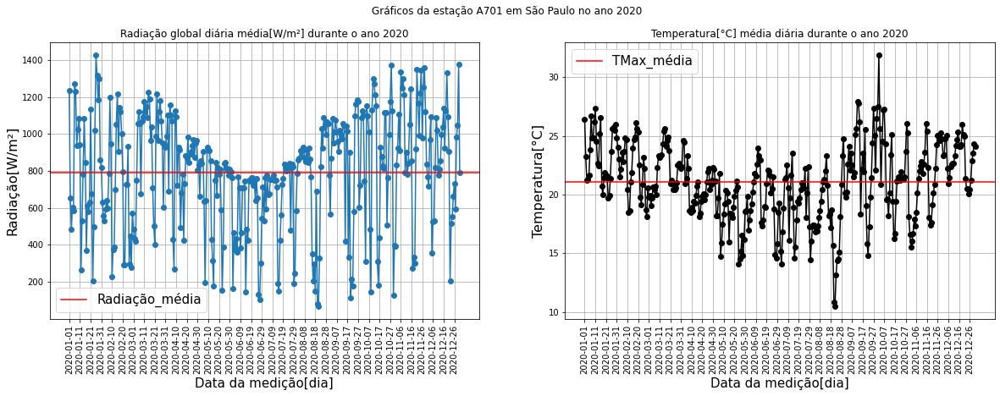

In [48]:
graficos_subplot(df_dia_A701)

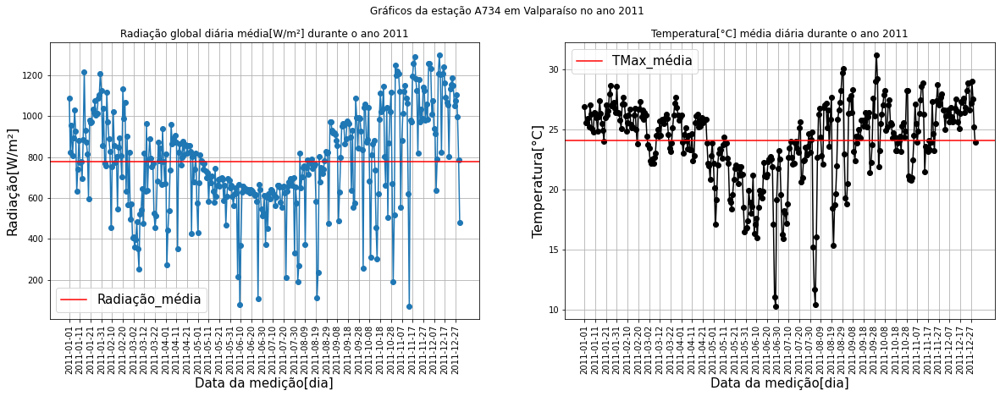

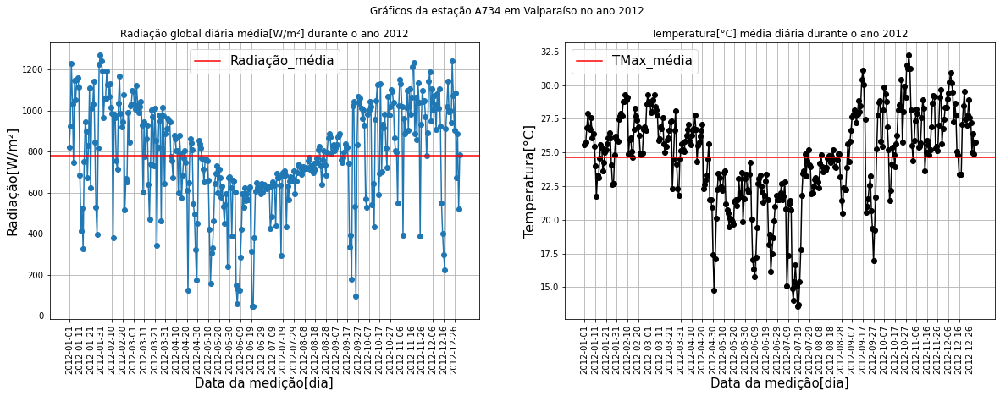

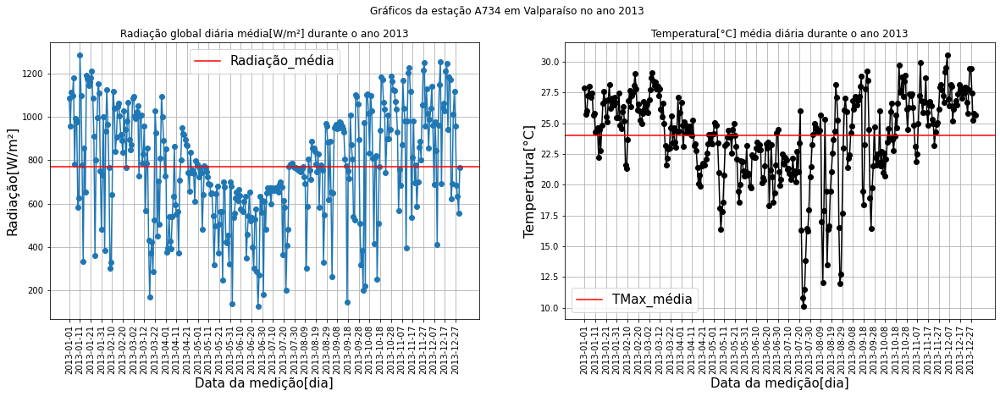

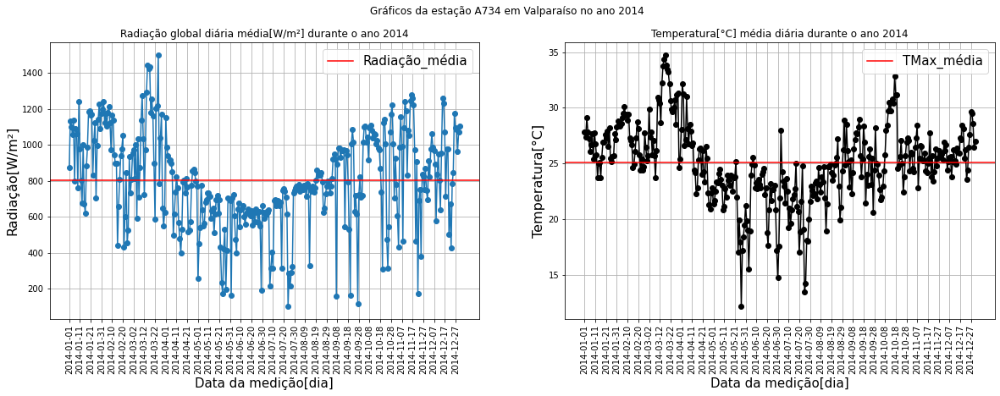

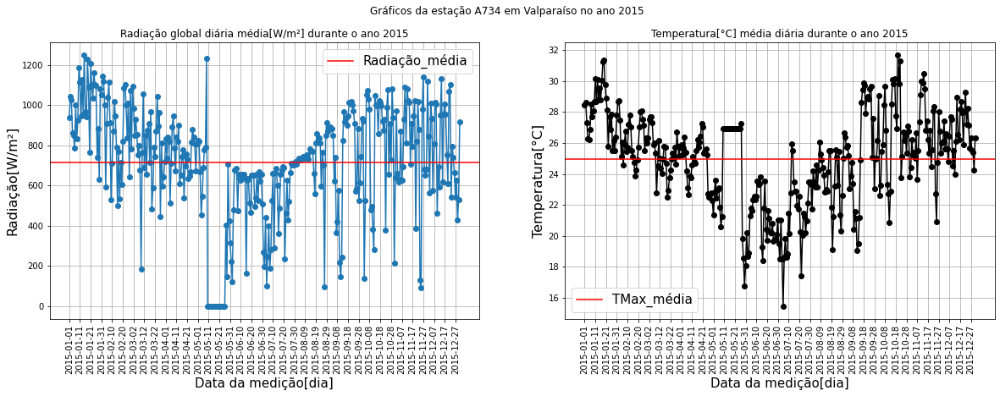

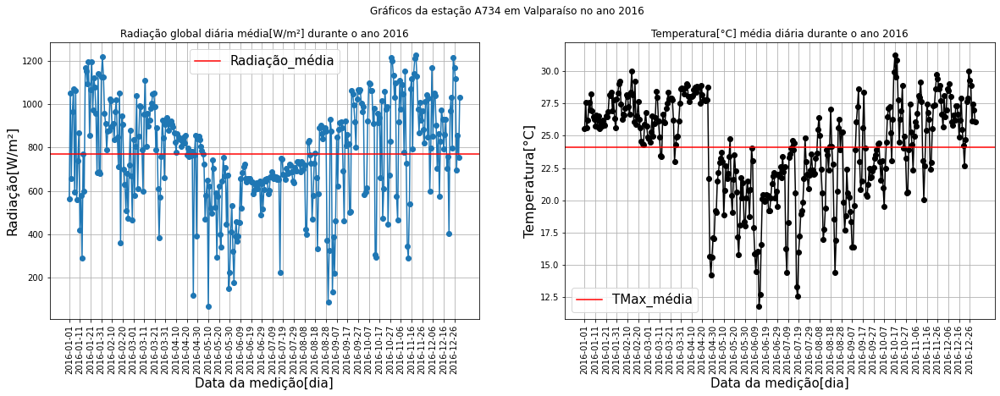

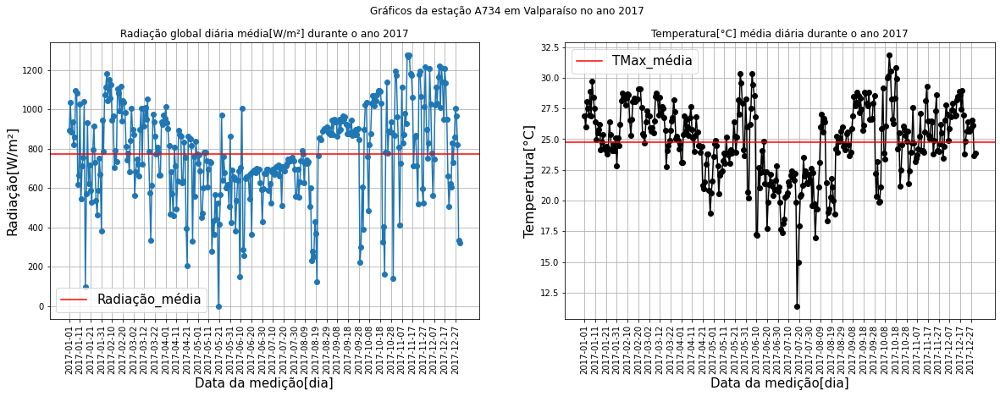

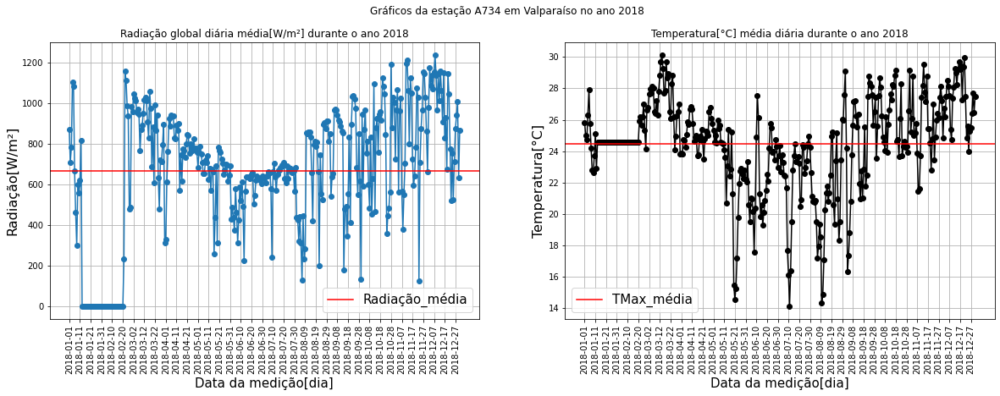

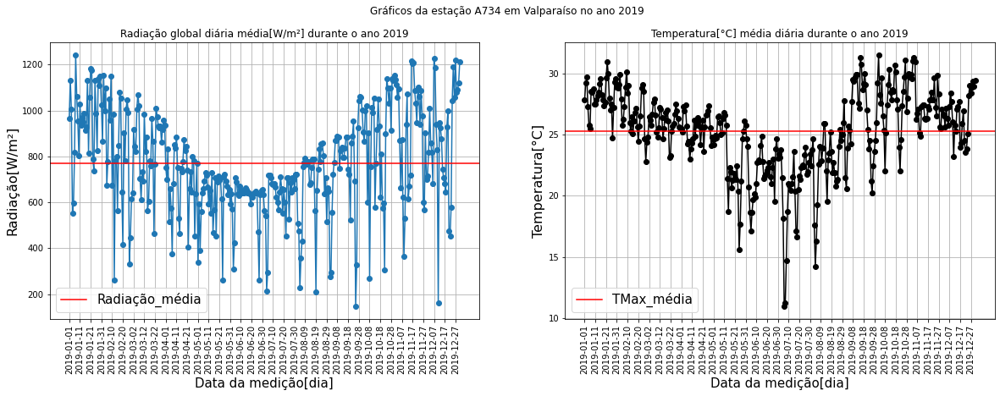

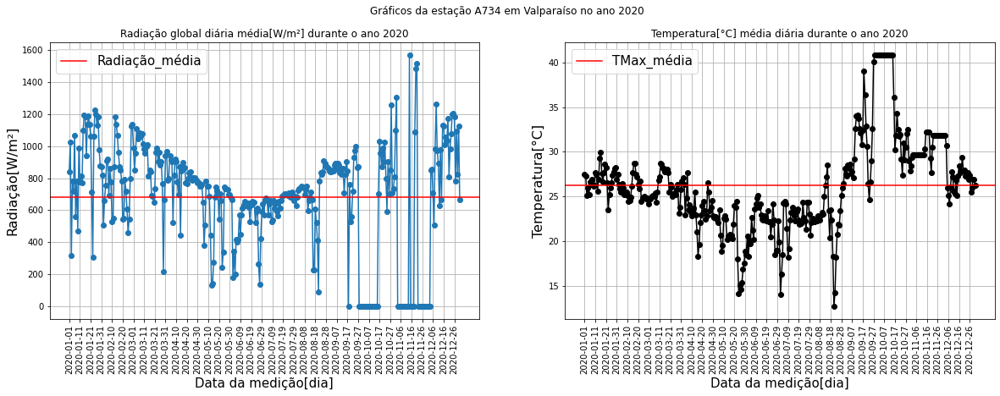

In [49]:
graficos_subplot(df_dia_A734)

In [50]:
def plotly_bar(df_filtro1 = df_ano_estacoes[df_ano_estacoes['estacao']=='A705'],
               df_filtro2 = df_ano_estacoes[df_ano_estacoes['estacao']=='A714'],
               df_filtro3 = df_ano_estacoes[df_ano_estacoes['estacao']=='A753'],
               df_filtro4 = df_ano_estacoes[df_ano_estacoes['estacao']=='A733'],
               df_filtro5 = df_ano_estacoes[df_ano_estacoes['estacao']=='A707'],
               df_filtro6 = df_ano_estacoes[df_ano_estacoes['estacao']=='A701'],
               df_filtro7 = df_ano_estacoes[df_ano_estacoes['estacao']=='A734'], 
               coluna1='ANO', coluna2='RAD' ):
    ''' x variavel quantitatida discreta, y variavel quantitativa continua'''
    import plotly.graph_objects as go
    import plotly.express as px
    
    title= f'Quantidade de {coluna2} em {coluna1}'
    ## Using figure function to define the data argument and setting it to the bars 
    fig = go.Figure(data = [go.Bar(x = df_filtro1[coluna1], y = df_filtro1[coluna2],\
                                   marker_color = 'mediumturquoise', name = df_filtro1.cidade.values[0]),
                            go.Bar(x = df_filtro2[coluna1], y = df_filtro2[coluna2],\
                                   marker_color = 'lightslategray', name = df_filtro2.cidade.values[0]),
                            go.Bar(x = df_filtro3[coluna1], y = df_filtro3[coluna2],\
                                   marker_color = 'darkorchid', name = df_filtro3.cidade.values[0]),
                            go.Bar(x = df_filtro4[coluna1], y = df_filtro4[coluna2],\
                                   marker_color = 'blue', name = df_filtro4.cidade.values[0]),
                            go.Bar(x = df_filtro5[coluna1], y = df_filtro5[coluna2],\
                                   marker_color = 'darkgreen', name = df_filtro5.cidade.values[0]),
                            go.Bar(x = df_filtro6[coluna1], y = df_filtro6[coluna2],\
                                   marker_color = 'gold', name = df_filtro6.cidade.values[0]),
                            go.Bar(x = df_filtro7[coluna1], y = df_filtro7[coluna2],\
                                   marker_color = 'seagreen', name = df_filtro7.cidade.values[0]),
                           ])

    ## Setting the titles, xaxis and yaxis  
    fig.update_layout(title=title,
                       xaxis_title=f'{coluna1}',
                       yaxis_title=f'{coluna2}',
                       )

    return fig

In [51]:
plotly_bar()

In [52]:
# step 1 : Setting the figure function 
def plotly_Anos(coluna='RAD'):
    
    import plotly.graph_objects as go
    import plotly.express as px
    fig = go.Figure(data = [go.Scatter(x = df_ano_A701['ANO'], y = df_ano_A701[coluna],\
                                        line = dict(color = 'darkturquoise', width = 4),\
                                       text = df_ano_A701['cidade'][0], name = df_ano_A701['cidade'][0]),
                            go.Scatter(x = df_ano_A705['ANO'], y = df_ano_A705[coluna],\
                                       line = dict(color = 'blue', width = 4), text = df_ano_A705['cidade'][0], name =  df_ano_A705['cidade'][0]),
                           go.Scatter(x = df_ano_A707['ANO'], y = df_ano_A707[coluna],\
                                       line = dict(color = 'darkgreen', width = 4), text = df_ano_A707['cidade'][0], name = df_ano_A707['cidade'][0]), 
                           ])


    # step 2 : Setting the update_layout function   
    fig.update_layout(title=f'Variação de {coluna} ao longo dos anos',
                       xaxis_title='Years',
                       yaxis_title=f'{coluna}',
                       )
    return fig



In [53]:
plotly_Anos()

In [227]:
df_ano_estacoes.head()

,ANO,PRE_INS,TEM_SEN,VL_LATITUDE,PRE_MAX,RAD_GLO,PTO_INS,TEM_MIN,VL_LONGITUDE,UMD_MIN,PTO_MAX,VEN_DIR,CHUVA,PRE_MIN,UMD_MAX,VEN_VEL,PTO_MIN,TEM_MAX,VEN_RAJ,TEM_INS,UMD_INS,HR_MEDICAO,MES,HR,RAD,cidade,estacao
0,2011.0,942.558151,20.980160,-22.358052,942.814463,685.505770,15.293288,20.552032,-49.028877,69.703881,15.819703,135.624429,0.161096,942.301427,75.854795,1.564349,14.792100,21.816107,5.017420,21.172705,72.810845,1150.0,6.526027,12.5,687.057689,Bauru,A705
1,2012.0,943.225034,21.983208,-22.358052,943.481580,662.357637,16.216951,21.138354,-49.028877,71.055783,16.797518,134.023793,0.144581,942.968147,77.952527,1.434495,15.660417,22.395196,4.814663,21.754941,74.514572,1150.0,6.513661,12.5,663.410082,Bauru,A705
2,2013.0,943.478253,22.934852,-22.358052,943.774680,547.069309,17.027626,21.842911,-49.028877,69.906279,17.475753,117.749429,0.152466,943.265571,76.602626,1.294600,16.394007,22.880274,4.675320,22.373048,73.705936,1150.0,6.526027,12.5,520.703886,Bauru,A705
3,2014.0,944.083128,22.565217,-22.358052,944.419795,971.774246,14.960993,21.968242,-49.028877,62.605594,15.458653,131.019977,0.094521,943.856461,68.742694,1.348653,14.488174,23.346792,4.933767,22.727968,65.518379,1150.0,6.526027,12.5,596.675249,Bauru,A705
4,2015.0,943.551027,22.564224,-22.358052,943.821963,623.779933,16.724920,21.513847,-49.028877,71.586644,17.213242,137.476598,0.159041,943.281541,77.259932,1.127637,16.271164,22.708950,4.175091,22.095936,74.472374,1150.0,6.526027,12.5,625.302952,Bauru,A705


# Funções para os gráficos :

Gráfico de Radiação, temperatura máxima, pluviométrico e umidade instantânea.

In [55]:
def graf_RAD_dia(df):
    import matplotlib.pyplot as plt 
    
    df_dia = df.groupby(['DT_MEDICAO'],as_index=False).mean() 
    plt.figure(figsize=(20,5))
    plt.plot(df_dia['DT_MEDICAO'] , df_dia['RAD'],'o-',color='orange')
    plt.xlabel('Data da medição[dia]',fontsize= 15)
    plt.ylabel('Radiação[W/m²]',fontsize=16)
    plt.axhline(df['RAD'].mean(),c = 'red',label='Radiação_média')
    plt.grid(True, 'both','both')
    plt.xticks(df_dia.iloc[range(0,df_dia.shape[0],60),0],rotation=90)
    plt.legend(fontsize=15);

def graf_TEMP_dia(df):
    import matplotlib.pyplot as plt 
    
    df_dia = df.groupby(['DT_MEDICAO'],as_index=False).mean() 
    plt.figure(figsize=(20,5))
    plt.plot(df_dia['DT_MEDICAO'] , df_dia['TEM_MAX'],'o-', color = 'black')
    #plt.plot(df_dia['DT_MEDICAO'] , df_dia['TEM_MIN'],'o-')
    
    plt.xlabel('Data da medição[dia]',fontsize= 15)
    plt.ylabel('Temperatura[°C]',fontsize=16)
    
    plt.axhline(df['TEM_MAX'].mean(),c = 'red',label='TMax_média')
   # plt.axhline(df['TEM_MIN'].mean(),c = 'purple',label='TMin_média')
    plt.grid(True, 'both','both')
    plt.xticks(df_dia.iloc[range(0,df_dia.shape[0],60),0],rotation=90)
    plt.legend(fontsize=15);

def graf_PLUV_dia(df):
    import matplotlib.pyplot as plt 
    
    df_dia = df.groupby(['DT_MEDICAO'],as_index=False).mean() 
    plt.figure(figsize=(20,5))
    plt.scatter(df_dia['DT_MEDICAO'] , df_dia['CHUVA'],alpha=0.6,color = 'blue')
    plt.xlabel('Data da medição[dia]',fontsize= 15)
    plt.ylabel('Chuva[mm/dia]',fontsize=16)
    plt.axhline(df['CHUVA'].mean(),c = 'red',label='Chuva_média')
    plt.grid(True, 'both','both')
    plt.xticks(df_dia.iloc[range(0,df_dia.shape[0],60),0],rotation=90)
    plt.legend(fontsize=15);

def graf_UMID_dia(df):
    import matplotlib.pyplot as plt 
    
    df_dia = df.groupby(['DT_MEDICAO'],as_index=False).mean() 
    plt.figure(figsize=(20,5))
    plt.scatter(df_dia['DT_MEDICAO'] , df_dia['UMD_INS'],1,color = 'purple')
    plt.xlabel('Data da medição[dia]',fontsize= 15)
    plt.ylabel('UMIDADE RELATIVA DO AR [MÉDIA_DIÁRIA %] ',fontsize=16)
    plt.axhline(df['UMD_INS'].mean(),c = 'red',label='umidade_média_anual')
    plt.grid(True, 'both','both')
    plt.xticks(df_dia.iloc[range(0,df_dia.shape[0],60),0],rotation=90)
    plt.legend(fontsize=15);

def hist_RAD(df):
    import matplotlib.pyplot as plt 
    df_dia = df.groupby(['DT_MEDICAO'],as_index=False).mean() 
    #plt.figure(figsize=(10,6))
    sns.histplot(data = df_dia,x='RAD', kde = True)
    plt.xlabel('Radiação[W/m²]',fontsize=16)
    plt.suptitle('Frequência Radiação dias/ano}',fontsize=15)
    plt.grid(True, 'both','both')
    #sns.set_style('whitegrid');
    
# função para gerar um histgrama a partir de uma variável do data frame
def gerar_histograma(data_frame,
                     variavel, 
                     bins = 30,
                     color = 'purple',
                     xlabel = 'Variável',
                     ylabel = 'Frequência',
                     titulo = 'Histograma',
                     fontsize = 16,
                     fontweight = 'bold',
                     figsize = (8,5)
                    ):
    fig, ax = plt.subplots(figsize = figsize)
    sns.histplot(data_frame[variavel], bins = bins, color = color, kde = True)
    ax.set(xlabel = xlabel, ylabel = ylabel)
    ax.set_title(titulo, fontsize = fontsize, fontweight = fontweight)
    plt.grid(True, 'both','both');

---

# Mapas

In [56]:
import os
import folium

print(folium.__version__)

from folium.plugins import HeatMap
from geopy.geocoders import Nominatim

0.12.1.post1


In [57]:
from geopy.geocoders import Nominatim
geolocator = Nominatim(user_agent="HeatMapAuto")
geocodes = lista_estacoes[['VL_LATITUDE','VL_LONGITUDE']]

a = np.matrix(geocodes)
dfa = pd.DataFrame(a)
dfa.rename(columns = {0:'latitute',1:'longitude'},inplace=True)
localizations = dfa
for i , r in dfa.iterrows():
    print(r['latitute'],r['longitude'])

-22.358052 -49.028877
-23.98194443 -48.88583333
-20.35972222 -47.77527777
-20.165 -50.59499999
-22.119867 -51.408637
-23.496294 -46.620088
-21.31916666 -50.93027777


In [58]:
m = folium.Map([-22, -50.], tiles='cartodb positron', zoom_start=7)

tooltip='Clique'

folium.Marker([-22.358052,-49.028877], popup="<b>BAURU - A705</b>", tooltip=tooltip, icon=folium.Icon(icon="cloud")).add_to(m)
folium.Marker([-23.98194443,-48.88583333], popup="<b>ITAPEVA - A714</b>", tooltip=tooltip, icon=folium.Icon(icon="cloud")).add_to(m)
folium.Marker([-20.35972222,-47.77527777], popup="<b>ITUVERAVA - A753</b>", tooltip=tooltip, icon=folium.Icon(icon="cloud")).add_to(m)
folium.Marker([-20.165,-50.59499999], popup="<b>JALES - A733</b>", tooltip=tooltip, icon=folium.Icon(icon="cloud")).add_to(m)
folium.Marker([-22.119867,-51.408637], popup="<b>PRESIDENTE PRUDENTE - A707</b>", tooltip=tooltip, icon=folium.Icon(icon="cloud")).add_to(m)
folium.Marker([-23.496294,-46.620088], popup="<b>SÃO PAULO - A701</b>", tooltip=tooltip, icon=folium.Icon(icon="cloud")).add_to(m)
folium.Marker([-21.31916666,-50.93027777], popup="<b>VALPARAÍSO - A771</b>", tooltip=tooltip, icon=folium.Icon(icon="cloud")).add_to(m)
m
#m.save(os.path.join('results', 'Heatmap3.html'))

In [59]:
m1 = folium.Map([-22, -50.], tiles='cartodb positron', zoom_start=7)

tooltip='Clique!'

folium.CircleMarker([-22.358052,-49.028877], radius=40,
    popup= "<b>BAURU</b>",
    color="#3186cc",
    fill=True,
    fill_color="#3186cc",
                   tooltip='A705').add_to(m1)
folium.CircleMarker([-23.98194443,-48.88583333], radius=35,
    popup= "<b>ITAPEVA</b>",
    color="#3186cc",
    fill=True,
    fill_color="#3186cc",
                   tooltip='A714').add_to(m1)
folium.CircleMarker([-20.35972222,-47.77527777], radius=30,
    popup= "<b>ITUVERAVA</b>",
    color="#3186cc",
    fill=True,
    fill_color="#3186cc",
                   tooltip='A753').add_to(m1)
folium.CircleMarker([-20.165,-50.59499999],radius=30,
    popup= "<b>JALES</b>",
    color="#3186cc",
    fill=True,
    fill_color="#3186cc",
                   tooltip='A733').add_to(m1)
folium.CircleMarker([-22.119867,-51.408637],  radius=30,
    popup="<b>PRESIDENTE PRUDENTE</b>",
    color="#3186cc",
    fill=True,
    fill_color="#3186cc",
                   tooltip='A707').add_to(m1)
folium.CircleMarker([-23.496294,-46.620088], radius=60,
    popup="<b>SÃO PAULO</b>", 
    color="#3186cc",
    fill=True,
    fill_color="#3186cc",
                   tooltip='A701').add_to(m1)
folium.Circle([-21.31916666,-50.93027777],radius=100, 
    popup="<b>VALPARAÍSO - A771</b>", 
    color="crimson",
    fill=False,
    fill_color="#3186cc",
                   tooltip=tooltip).add_to(m1)
m1

In [60]:
def mapa_com_bin(numero_estado = 35,
                coluna = 'RAD',
                legend_name=" Radiação média durante 2011 a 2021 W/m²",
                save = 0):    

    '''
    Verifica se coluna cidade está escrito do jeito da geodata: https://github.com/tbrugz/geodata-br
    também lá que verifica o numero do estado.    
    
    Se save = 1, ele vai salvar o mapa em arquivo .html, em uma pasta
    que deve ser criada chamada results.
    '''
    import os
    import folium
    from geopy.geocoders import Nominatim
    
    state_geo = f"https://raw.githubusercontent.com/tbrugz/geodata-br/master/geojson/geojs-{numero_estado}-mun.json"
    state_data = df_ano_estacoes.groupby('cidade')[['cidade',f'{coluna}']].mean().reset_index()
    print(state_data)
    print('')
    
    bins = list(state_data[f'{coluna}'].quantile([0, 0.25, 0.5, 0.75, 1]))
    #print(bins)
    
    m = folium.Map(location=[-22, -50.], zoom_start=7)

    folium.Choropleth(
        geo_data=state_geo,
        data=state_data,
        columns=['cidade',f'{coluna}'],
        key_on="feature.properties.name",
        fill_color="BuPu",
        fill_opacity=0.7,
        line_opacity=0.5,
        bins=bins,
        reset=True,
    ).add_to(m)
                 
    if (save == 1):
        m.save(os.path.join('results', 'mapa.html'))
        print('Arquivo salvo como mapa.html na pasta results criada')
    else:
        print('Arquivo não salvo.')
        
    return(m)

In [61]:
mapa_com_bin(coluna ='TEM_MAX' )

                cidade    TEM_MAX
0                Bauru  22.725182
1              Itapeva  20.754307
2            Ituverava  25.017637
3                Jales  25.802806
4  Presidente Prudente  24.637314
5            São Paulo  21.064252
6           Valparaíso  24.915028

Arquivo não salvo.


In [62]:
mapa_com_bin(coluna ='RAD' )

                cidade         RAD
0                Bauru  618.047312
1              Itapeva  687.609983
2            Ituverava  682.674884
3                Jales  840.717574
4  Presidente Prudente  605.242029
5            São Paulo  724.603975
6           Valparaíso  764.542992

Arquivo não salvo.
